In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from matplotlib import patches as patch
import matplotlib.animation as anim
from IPython.display import HTML
from skimage import measure
import time
from matplotlib.patches import Rectangle


# Face Detection

In [2]:
import cv2
import sys
import logging as log
import datetime as dt
from time import sleep

cascPath = cv2.data.haarcascades + "haarcascade_frontalface_default.xml"
faceCascade = cv2.CascadeClassifier(cascPath)
log.basicConfig(filename='webcam.log',level=log.INFO)

video_capture = cv2.VideoCapture(0)
anterior = 0

while True:
    if not video_capture.isOpened():
        print('Unable to load camera.')
        sleep(5)
        pass

    # Capture frame-by-frame
    ret, frame = video_capture.read()

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    faces = faceCascade.detectMultiScale(
        gray,
        scaleFactor=1.1,
        minNeighbors=5,
        minSize=(30, 30)
    )

    # Draw a rectangle around the faces
    for (x, y, w, h) in faces:
        cv2.rectangle(frame, (x, y), (x+w, y+h), (0, 255, 0), 2)

    if anterior != len(faces):
        anterior = len(faces)
        log.info("faces: "+str(len(faces))+" at "+str(dt.datetime.now()))


    # Display the resulting frame
    cv2.imshow('Video', frame)

    if cv2.waitKey(1) & 0xFF == ord('s'): 

        check, frame = video_capture.read()
        cv2.imshow("Capturing", frame)
        cv2.imwrite(filename='saved_img.jpg', img=frame)
        video_capture.release()
        img_new = cv2.imread('saved_img.jpg', cv2.IMREAD_GRAYSCALE)
        img_new = cv2.imshow("Captured Image", img_new)
        cv2.waitKey(1650)
        print("Image Saved")
        print("Program End")
        cv2.destroyAllWindows()

        break
    elif cv2.waitKey(1) & 0xFF == ord('q'):
        print("Turning off camera.")
        video_capture.release()
        print("Camera off.")
        print("Program ended.")
        cv2.destroyAllWindows()
        break

    # Display the resulting frame
    cv2.imshow('Video', frame)

# When everything is done, release the capture
video_capture.release()
cv2.destroyAllWindows()

KeyboardInterrupt: 

# Tracking

## Non-parametric Segmentation

In [284]:
def Non_Parametric_Segmentation(test,ROI,BINS):
#     r = cv2.selectROI(img)
#     ROI = img[int(r[1]):int(r[1]+r[3]), int(r[0]):int(r[0]+r[2])]
    img = np.copy(test)
    
    img = img/255
    ROI = ROI/255

    R = img[:,:,0]
    G = img[:,:,1]
    B = img[:,:,2]

    I = R+G+B

    I[I==0] = 10

    r = R/I
    g = G/I

    ROI_R = ROI[:,:,0]
    ROI_G = ROI[:,:,1]
    ROI_B = ROI[:,:,2]

    ROI_I = ROI_R+ROI_G+ROI_B
    ROI_r = ROI_R/ROI_I
    ROI_g = ROI_G/ROI_I

    r_roi_int = (ROI_r*(BINS-1)).astype(int)
    g_roi_int = (ROI_g*(BINS-1)).astype(int)
    
    matrix, xbin, ybin = np.histogram2d(g_roi_int.flatten(), r_roi_int.flatten(), bins = BINS, range = [[0,BINS],[0,BINS]])
    r_int, g_int = (r*(BINS-1)).astype(int), (g*(BINS-1)).astype(int)
    
    back_projection = np.zeros(r.shape)
    for i in range(r.shape[0]):
        for j in range(r.shape[1]):
            back_projection[i,j] = matrix[g_int[i,j], r_int[i,j]]
    
    return back_projection

In [285]:
import cv2

camera = cv2.VideoCapture(0)
return_value, image = camera.read()

r = cv2.selectROI(image)
ROI = image[int(r[1]):int(r[1]+r[3]), int(r[0]):int(r[0]+r[2])]

C:\ProgramData\Anaconda3\lib\site-packages\matplotlib\figure.py:2267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


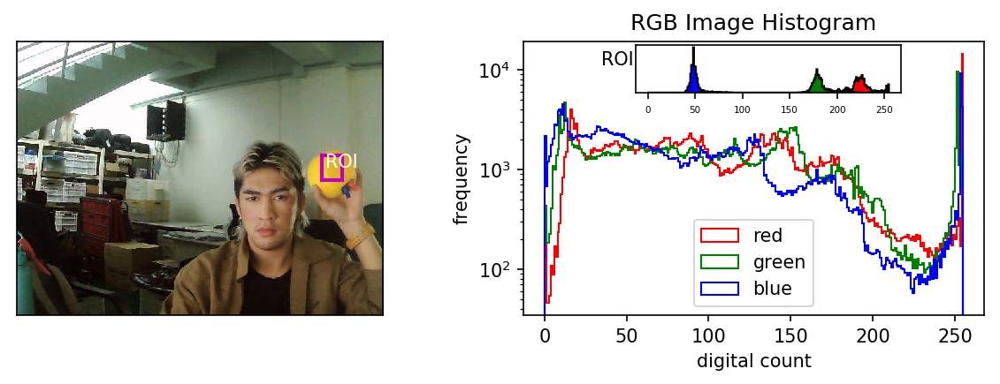

In [286]:
fig, ax = plt.subplots(1,2, figsize = (8,3), dpi = 150)

ax[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
ax[0].set_xticks([])
ax[0].set_yticks([])

r_coords = r
rect = Rectangle((r_coords[0],r_coords[1]),
                     r_coords[2],r_coords[3],
                     linewidth=2,edgecolor='m',facecolor='none')
ax[0].add_patch(rect)
ax[0].annotate("ROI", (r_coords[0]+r_coords[2]/5, r_coords[1]+r_coords[3]/2), color = 'w')


ax[1].hist(image[:,:,2].flatten(), bins = 256, range = [0,255], histtype = "step", ec = 'r', label = 'red')
ax[1].hist(image[:,:,1].flatten(), bins = 256, range = [0,255], histtype = "step", ec = 'g', label = 'green')
ax[1].hist(image[:,:,0].flatten(), bins = 256, range = [0,255], histtype = "step", ec = 'b', label = 'blue')

left, bottom, width, height = [0.65, 0.75, 0.25, 0.12]
ax2 = fig.add_axes([left, bottom, width, height])

ax2.hist(ROI[:,:,2].flatten(), bins = 256, range = [0,255], histtype = "stepfilled", fc = 'r', ec = 'k')
ax2.hist(ROI[:,:,1].flatten(), bins = 256, range = [0,255], histtype = "stepfilled", fc = 'g', ec = 'k')
ax2.hist(ROI[:,:,0].flatten(), bins = 256, range = [0,255], histtype = "stepfilled", fc = 'b', ec = 'k')
ax2.set_ylabel("ROI", fontsize = 10, rotation = 0, labelpad=10)
ax2.tick_params(axis='x', labelsize= 5)
ax2.set_yticks([])
# ax2.set_edgecolor('m')

# ax[1].grid()
ax[1].legend(loc =8)
ax[1].set_yscale("log")
ax[1].set_xlabel("digital count")
ax[1].set_ylabel("frequency")
ax[1].set_title("RGB Image Histogram")

plt.tight_layout()
plt.show()

In [287]:
def Non_parametric(test, ROI, BINS):
    img = np.copy(test)
    img = img/255
    ROI = ROI/255

    R = img[:,:,0]
    G = img[:,:,1]
    B = img[:,:,2]

    I = R+G+B

    I[I==0] = 10

    r = R/I
    g = G/I

    ROI_R = ROI[:,:,0]
    ROI_G = ROI[:,:,1]
    ROI_B = ROI[:,:,2]

    ROI_I = ROI_R+ROI_G+ROI_B
    ROI_r = ROI_R/ROI_I
    ROI_g = ROI_G/ROI_I

    r_roi_int = (ROI_r*(BINS-1)).astype(int)
    g_roi_int = (ROI_g*(BINS-1)).astype(int)

    matrix, xbin, ybin = np.histogram2d(g_roi_int.flatten(), r_roi_int.flatten(), bins = BINS, range = [[0,BINS],[0,BINS]])
    r_int, g_int = (r*(BINS-1)).astype(int), (g*(BINS-1)).astype(int)

    back_projection = np.zeros(r.shape)
    for i in range(r.shape[0]):
        for j in range(r.shape[1]):
            back_projection[i,j] = matrix[g_int[i,j], r_int[i,j]]
    
    return back_projection

(480, 0)

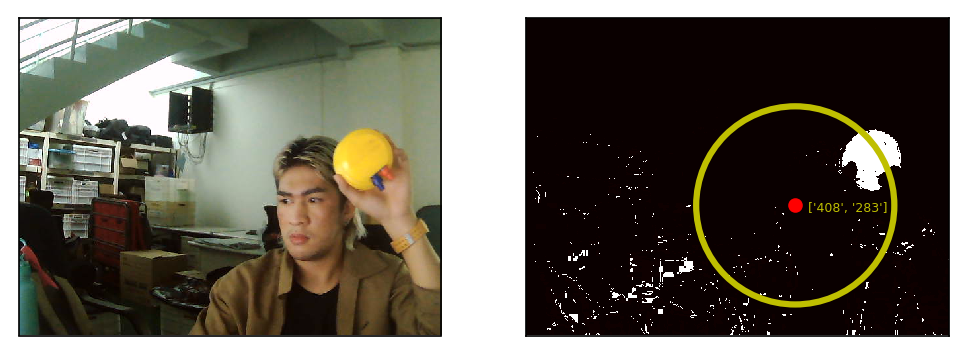

In [290]:
camera = cv2.VideoCapture(0)
return_value, test = camera.read()

fig, ax = plt.subplots(1,2, figsize = (8,3), dpi = 150)

ax[0].imshow(cv2.cvtColor(test, cv2.COLOR_BGR2RGB))
ax[0].set_xticks([])
ax[0].set_yticks([])

segmented = Non_parametric(test, ROI, BINS = 15)

ax[1].imshow(segmented, cmap = 'hot')

ret, thresh = cv2.threshold(segmented, 100,255, 0)
M = cv2.moments(thresh)
cX = int(M["m10"] / M["m00"])
cY = int(M["m01"] / M["m00"])

circle = plt.Circle((cX, cY), 150, linewidth=3,edgecolor='y',facecolor='none')
ax[1].add_patch(circle)
ax[1].plot(cX, cY, 'ro')
ax[1].text(cX+20,cY+10,[str(int(cX)),str(int(cY))], color = "y", fontsize = 6)
ax[1].set_xticks([])
ax[1].set_yticks([])
ax[1].set_xlim(0,640)
ax[1].set_ylim(480,0)

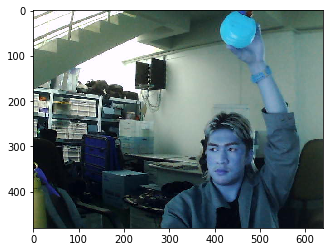

In [268]:
camera = cv2.VideoCapture(0)
return_value, test = camera.read()
plt.imshow(test)

In [279]:
camera = cv2.VideoCapture(0)
test_ = []

i = 1
while i < 50:
    print("Capturing Frame: " + str(i))
    return_value, test = camera.read()
    test_.append(test)
    i += 1
del(camera)

Capturing Frame: 1
Capturing Frame: 2
Capturing Frame: 3
Capturing Frame: 4
Capturing Frame: 5
Capturing Frame: 6
Capturing Frame: 7
Capturing Frame: 8
Capturing Frame: 9
Capturing Frame: 10
Capturing Frame: 11
Capturing Frame: 12
Capturing Frame: 13
Capturing Frame: 14
Capturing Frame: 15
Capturing Frame: 16
Capturing Frame: 17
Capturing Frame: 18
Capturing Frame: 19
Capturing Frame: 20
Capturing Frame: 21
Capturing Frame: 22
Capturing Frame: 23
Capturing Frame: 24
Capturing Frame: 25
Capturing Frame: 26
Capturing Frame: 27
Capturing Frame: 28
Capturing Frame: 29
Capturing Frame: 30
Capturing Frame: 31
Capturing Frame: 32
Capturing Frame: 33
Capturing Frame: 34
Capturing Frame: 35
Capturing Frame: 36
Capturing Frame: 37
Capturing Frame: 38
Capturing Frame: 39
Capturing Frame: 40
Capturing Frame: 41
Capturing Frame: 42
Capturing Frame: 43
Capturing Frame: 44
Capturing Frame: 45
Capturing Frame: 46
Capturing Frame: 47
Capturing Frame: 48
Capturing Frame: 49


Processing Frame: 0


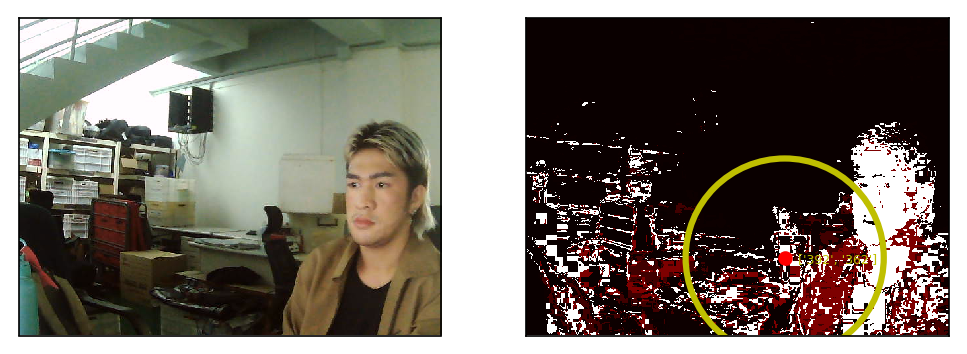

Processing Frame: 1


<Figure size 432x288 with 0 Axes>

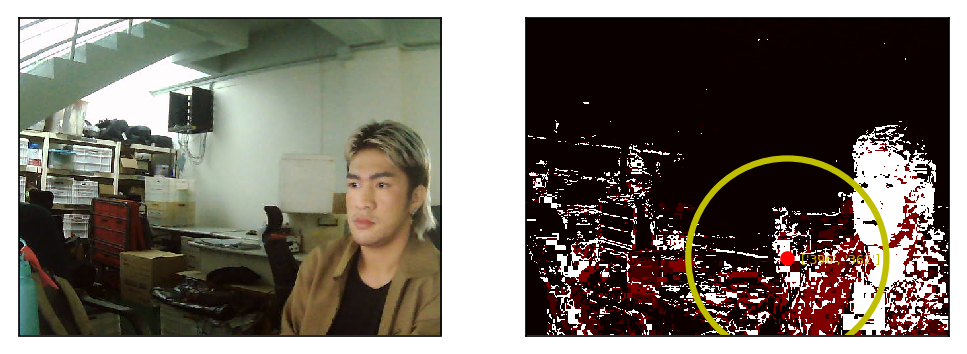

Processing Frame: 2


<Figure size 432x288 with 0 Axes>

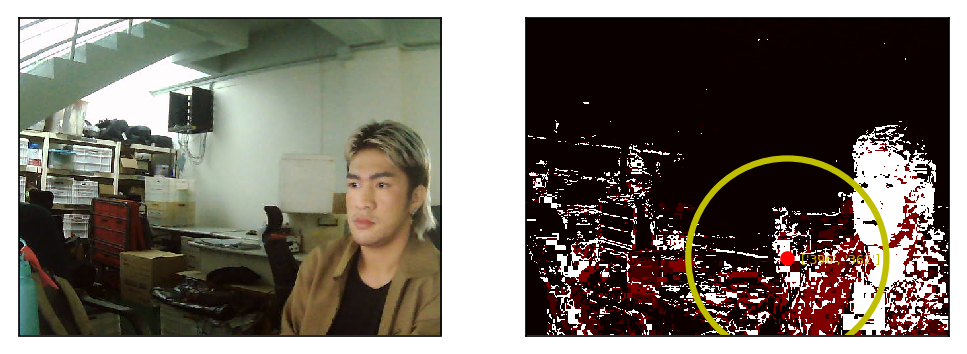

Processing Frame: 3


<Figure size 432x288 with 0 Axes>

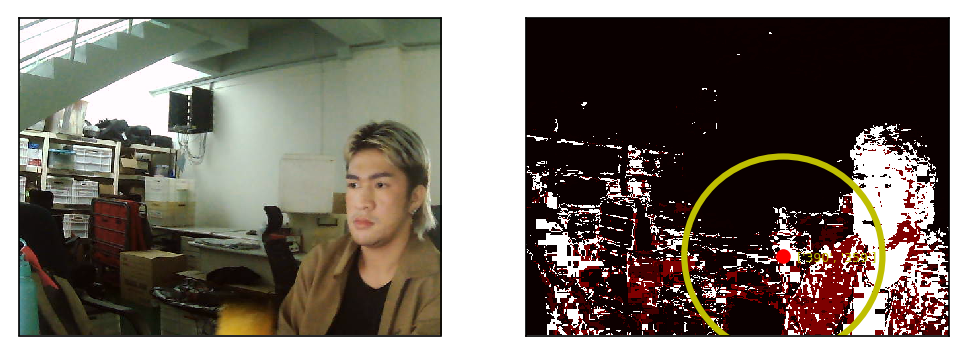

Processing Frame: 4


<Figure size 432x288 with 0 Axes>

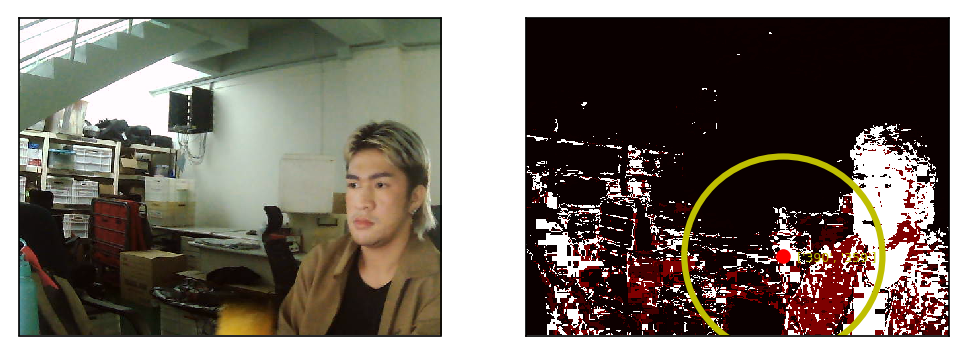

Processing Frame: 5


<Figure size 432x288 with 0 Axes>

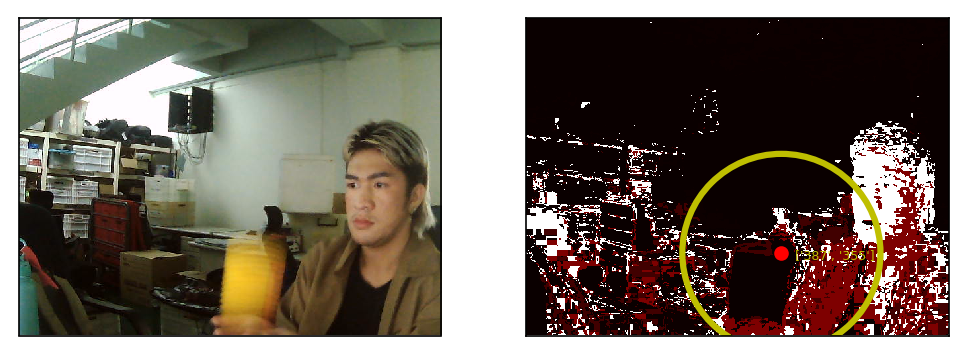

Processing Frame: 6


<Figure size 432x288 with 0 Axes>

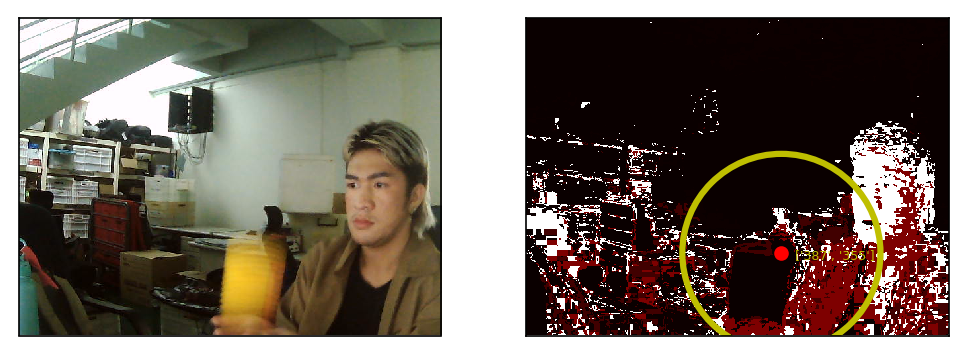

Processing Frame: 7


<Figure size 432x288 with 0 Axes>

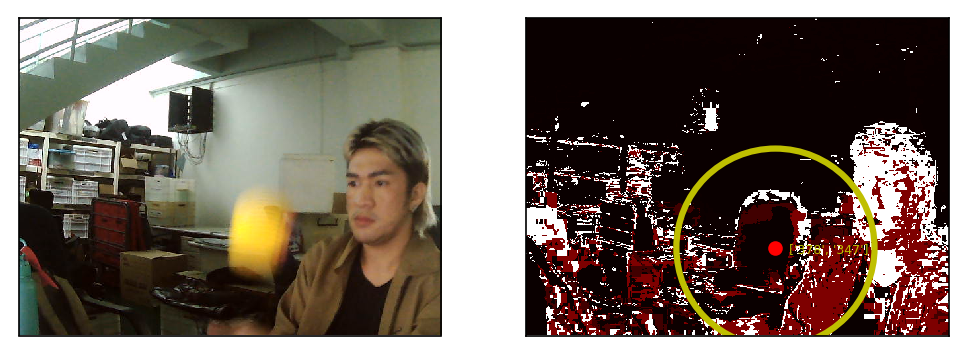

Processing Frame: 8


<Figure size 432x288 with 0 Axes>

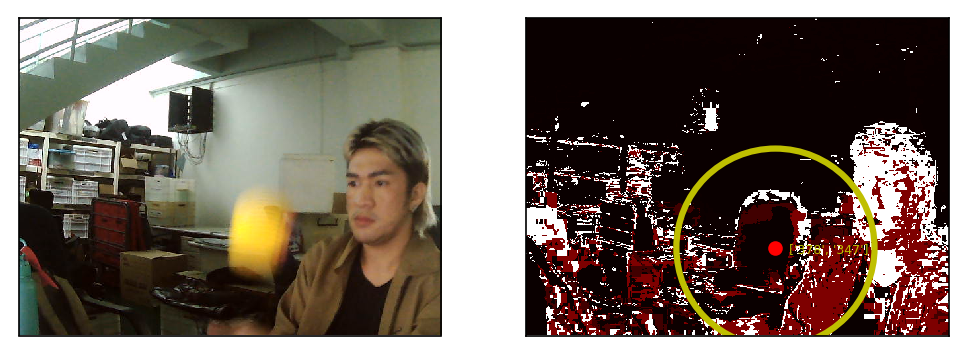

Processing Frame: 9


<Figure size 432x288 with 0 Axes>

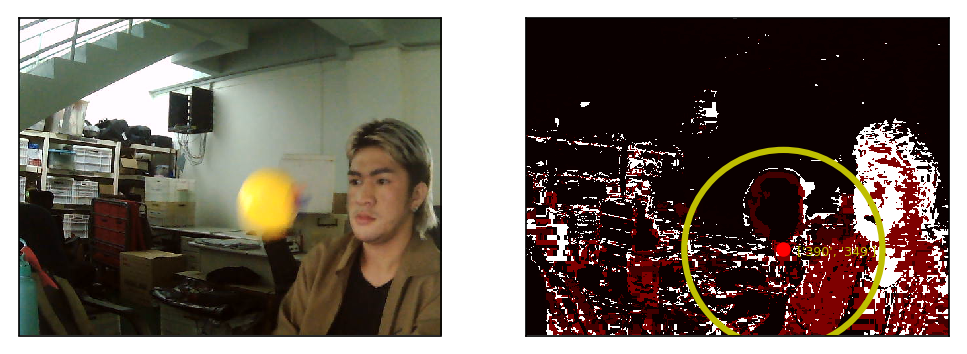

Processing Frame: 10


<Figure size 432x288 with 0 Axes>

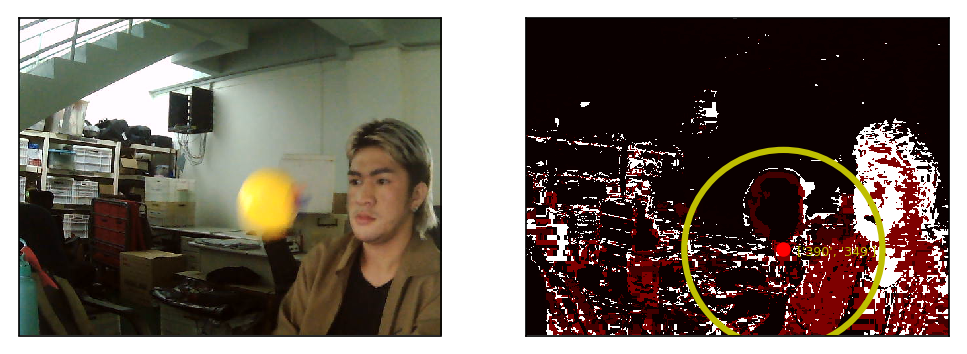

Processing Frame: 11


<Figure size 432x288 with 0 Axes>

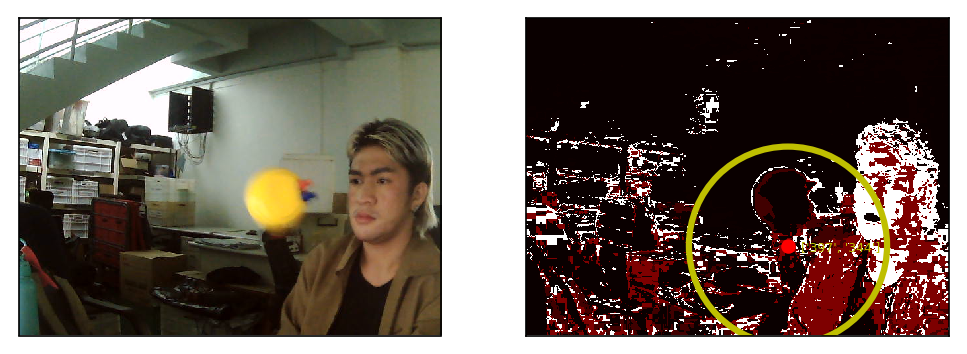

Processing Frame: 12


<Figure size 432x288 with 0 Axes>

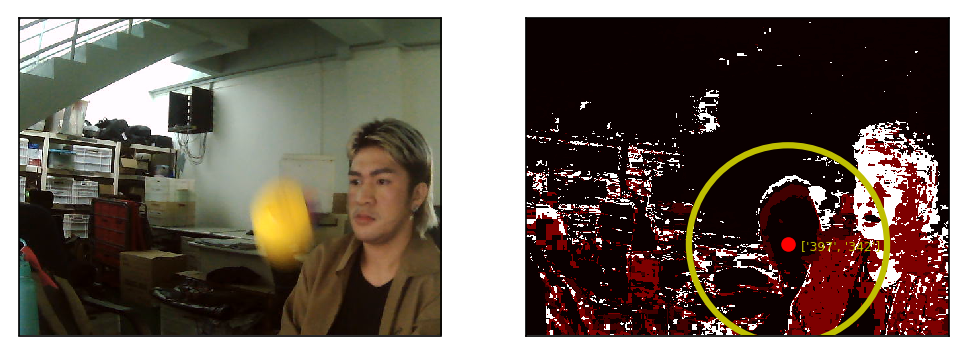

Processing Frame: 13


<Figure size 432x288 with 0 Axes>

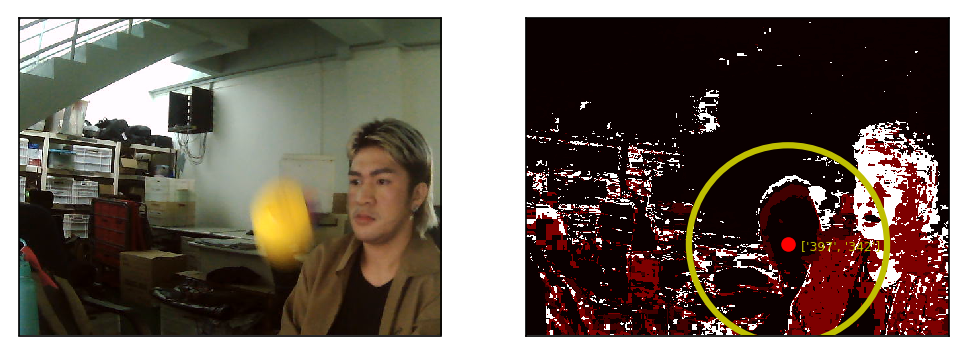

Processing Frame: 14


<Figure size 432x288 with 0 Axes>

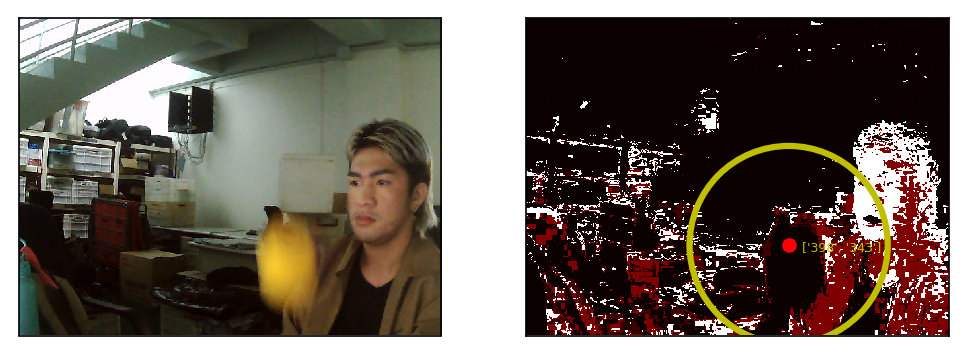

Processing Frame: 15


<Figure size 432x288 with 0 Axes>

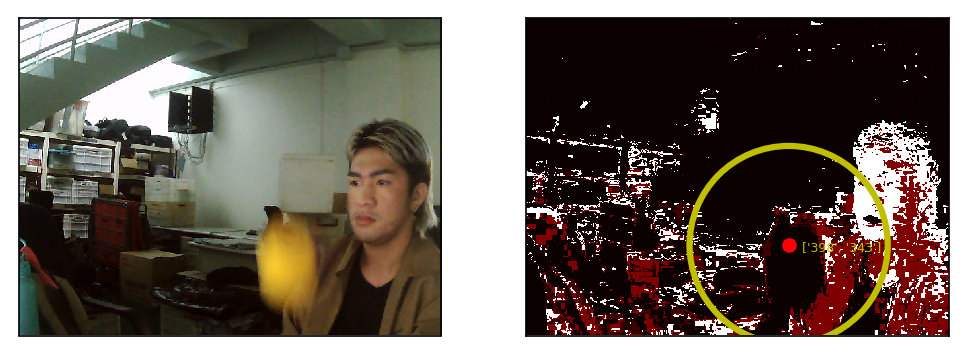

Processing Frame: 16


<Figure size 432x288 with 0 Axes>

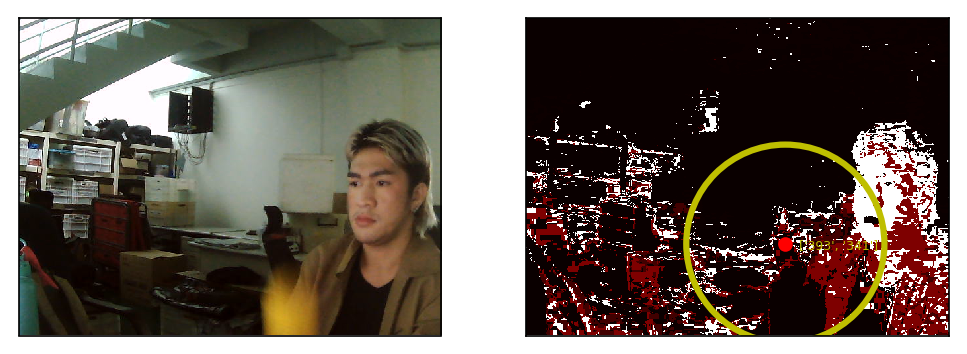

Processing Frame: 17


<Figure size 432x288 with 0 Axes>

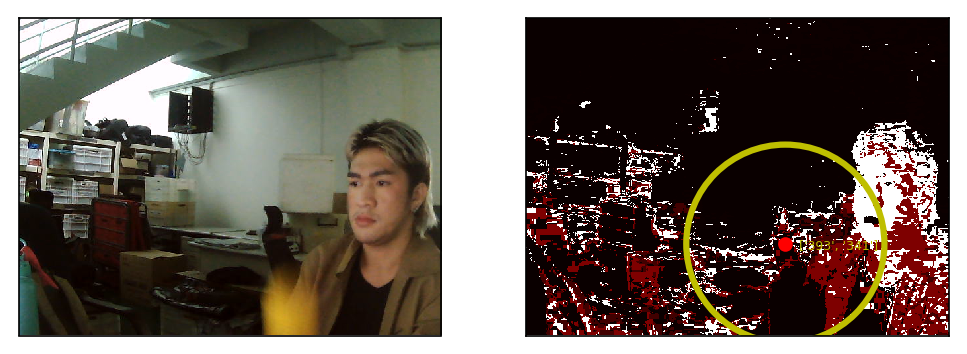

Processing Frame: 18


<Figure size 432x288 with 0 Axes>

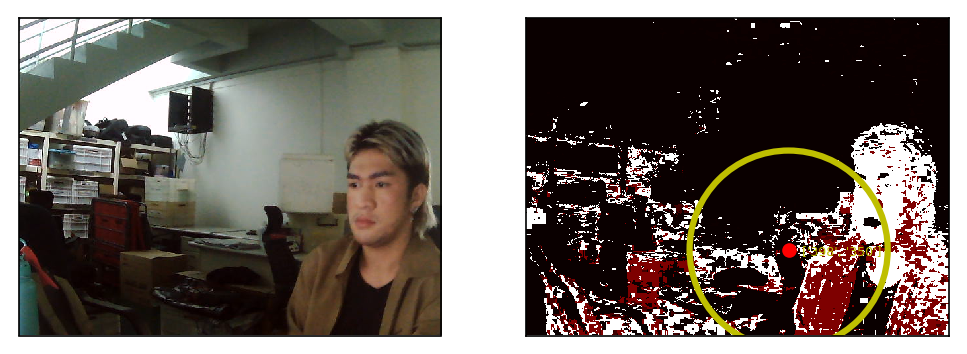

Processing Frame: 19


<Figure size 432x288 with 0 Axes>

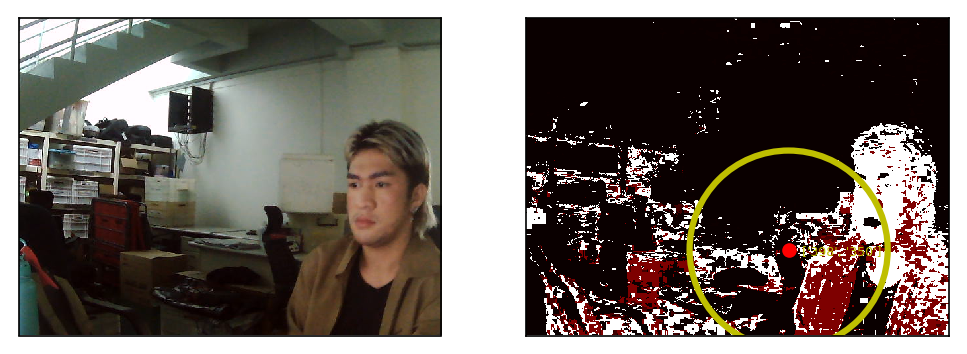

Processing Frame: 20


<Figure size 432x288 with 0 Axes>

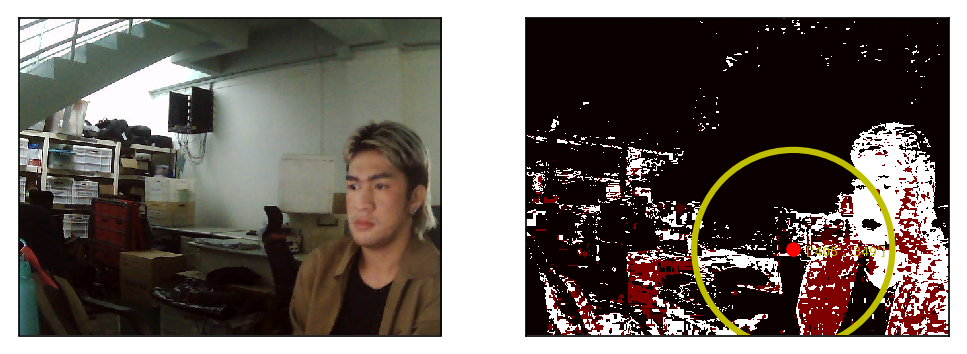

Processing Frame: 21


<Figure size 432x288 with 0 Axes>

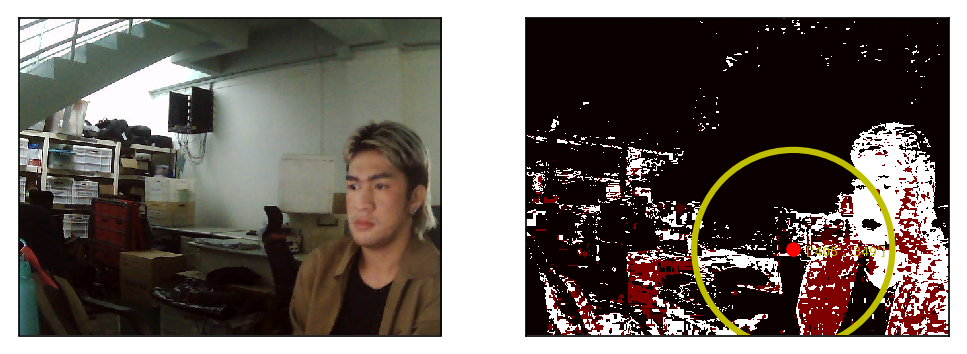

Processing Frame: 22


<Figure size 432x288 with 0 Axes>

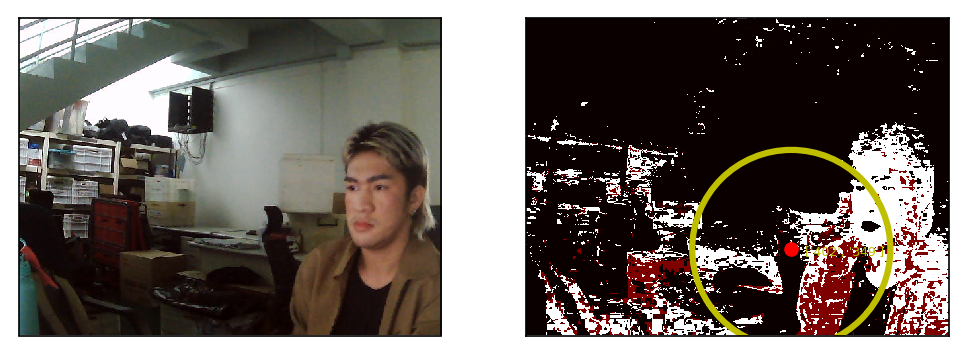

Processing Frame: 23


<Figure size 432x288 with 0 Axes>

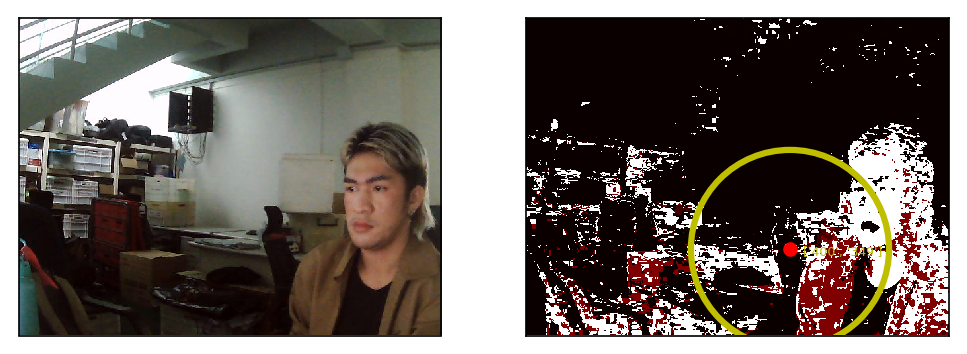

Processing Frame: 24


<Figure size 432x288 with 0 Axes>

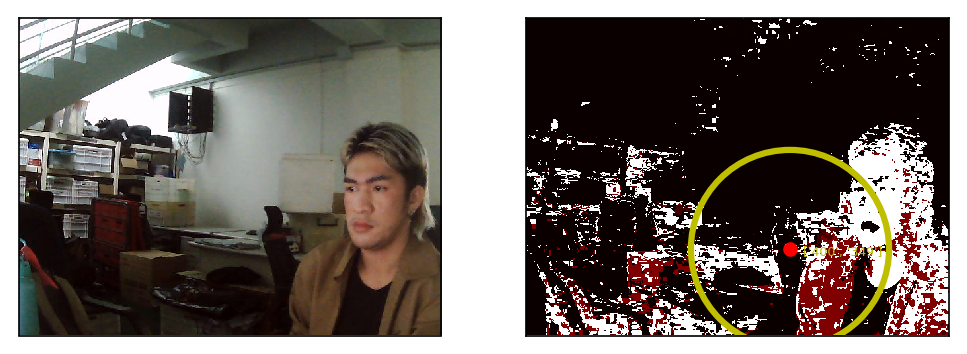

Processing Frame: 25


<Figure size 432x288 with 0 Axes>

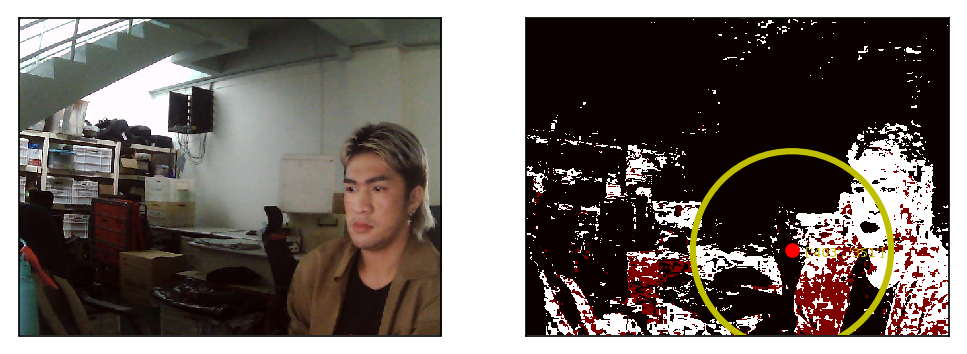

Processing Frame: 26


<Figure size 432x288 with 0 Axes>

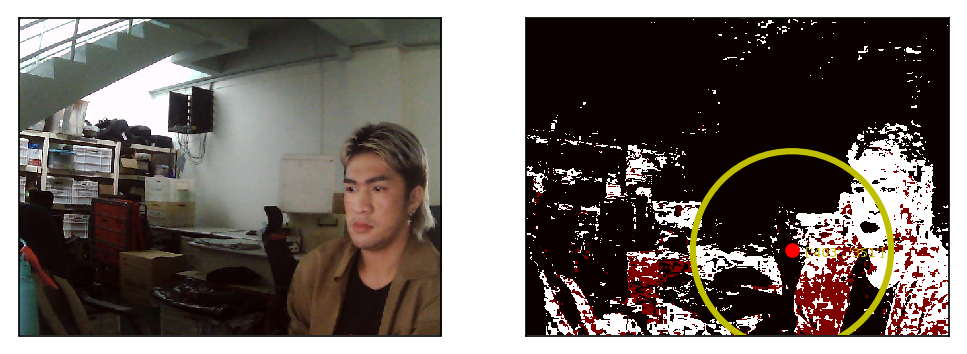

Processing Frame: 27


<Figure size 432x288 with 0 Axes>

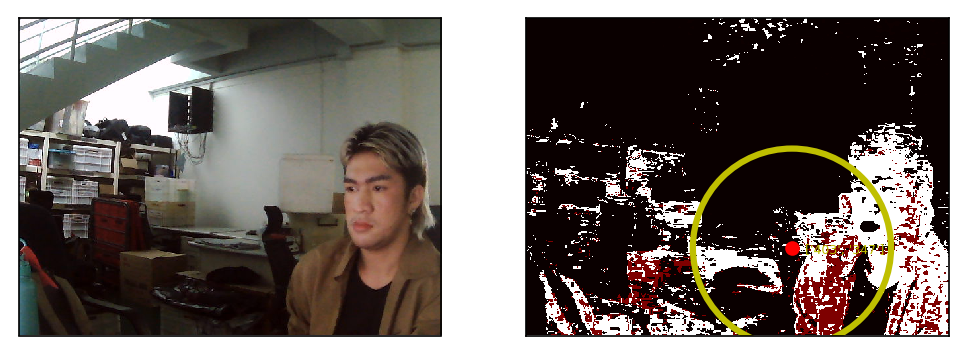

Processing Frame: 28


<Figure size 432x288 with 0 Axes>

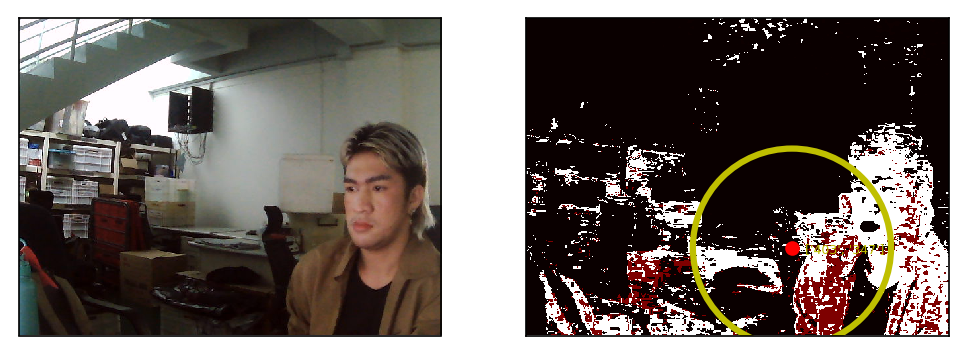

Processing Frame: 29


<Figure size 432x288 with 0 Axes>

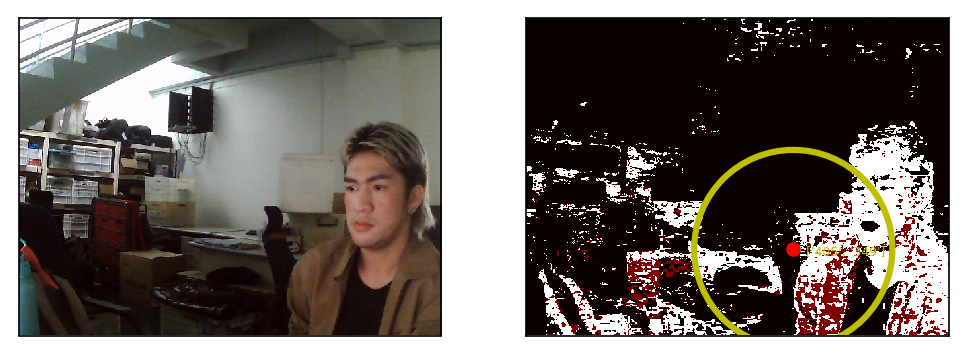

Processing Frame: 30


<Figure size 432x288 with 0 Axes>

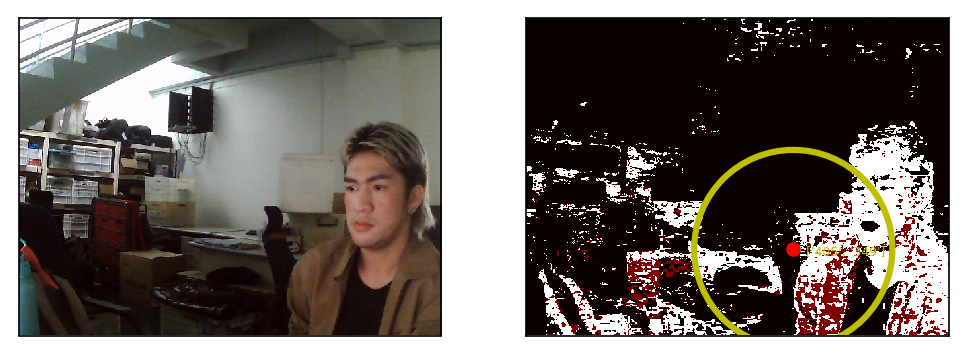

Processing Frame: 31


<Figure size 432x288 with 0 Axes>

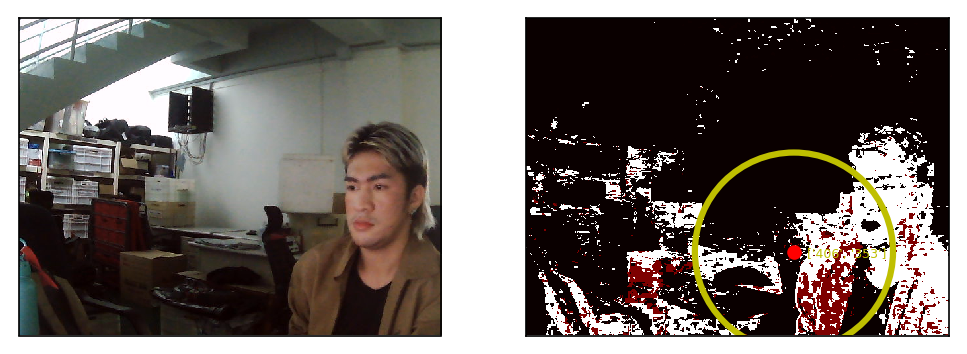

Processing Frame: 32


<Figure size 432x288 with 0 Axes>

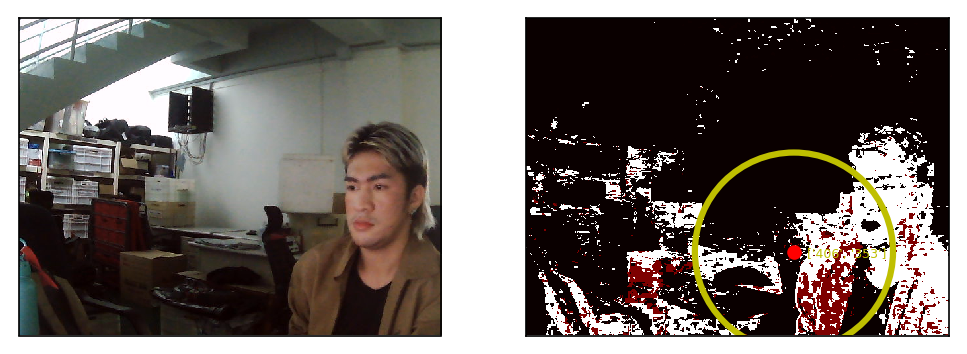

Processing Frame: 33


<Figure size 432x288 with 0 Axes>

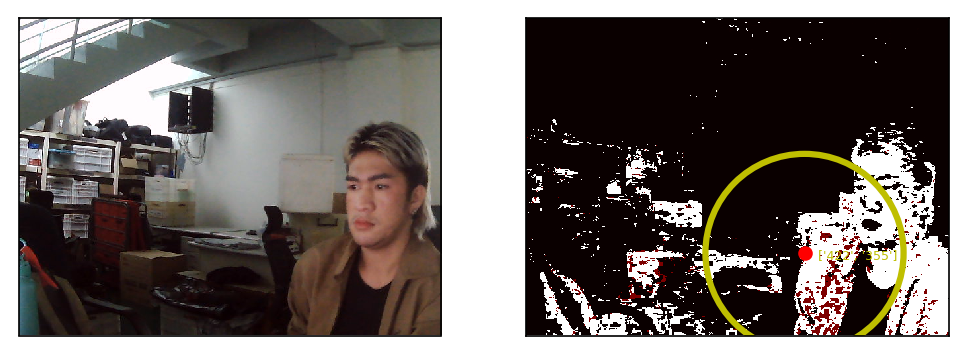

Processing Frame: 34


<Figure size 432x288 with 0 Axes>

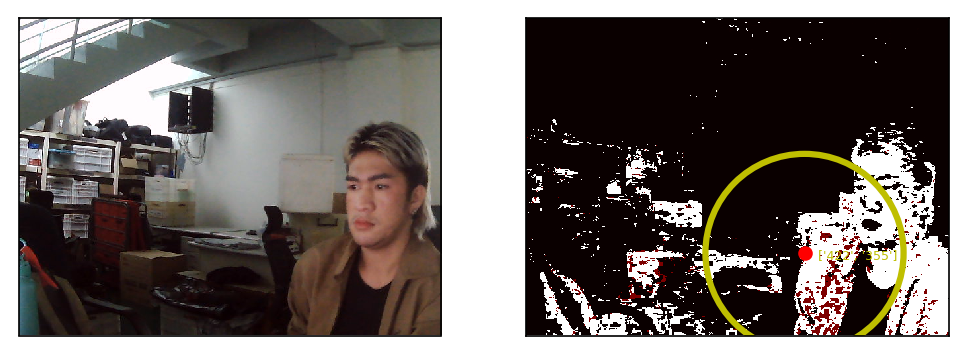

Processing Frame: 35


<Figure size 432x288 with 0 Axes>

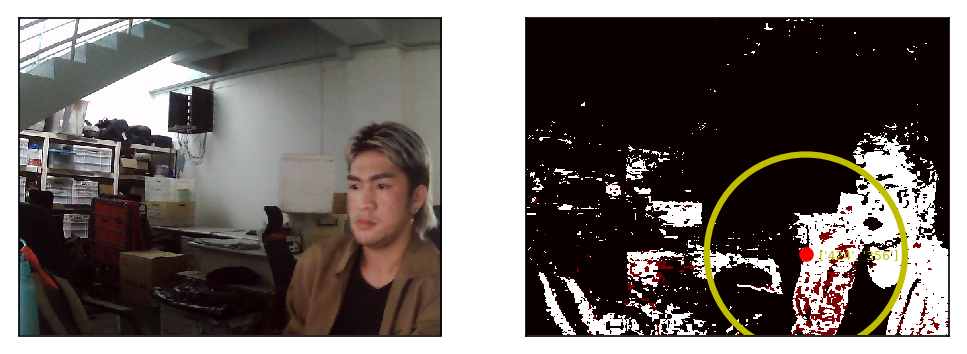

Processing Frame: 36


<Figure size 432x288 with 0 Axes>

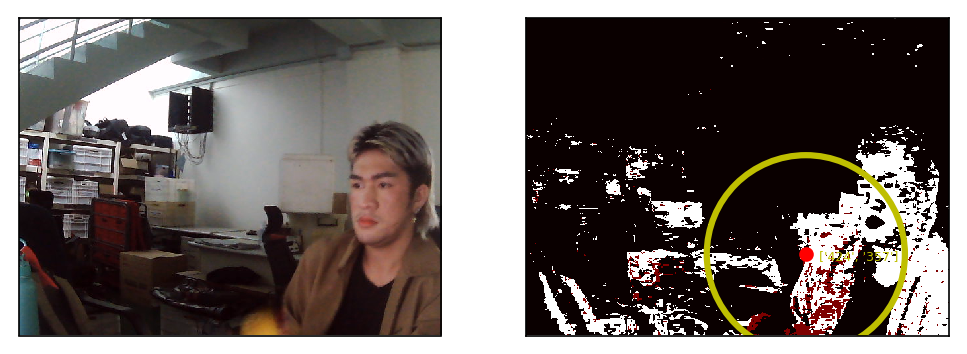

Processing Frame: 37


<Figure size 432x288 with 0 Axes>

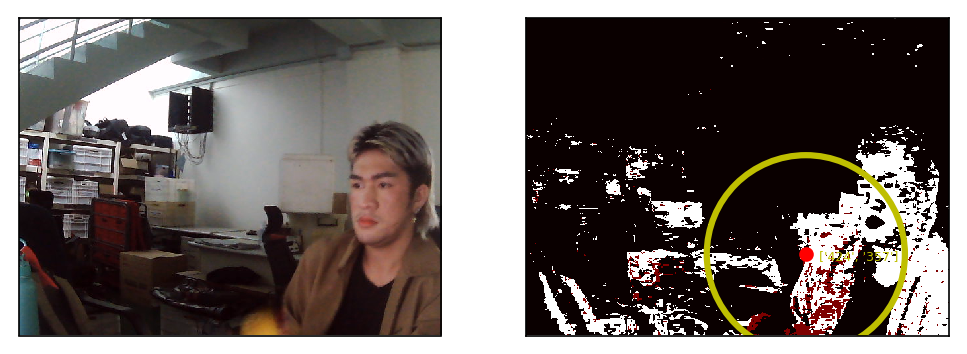

Processing Frame: 38


<Figure size 432x288 with 0 Axes>

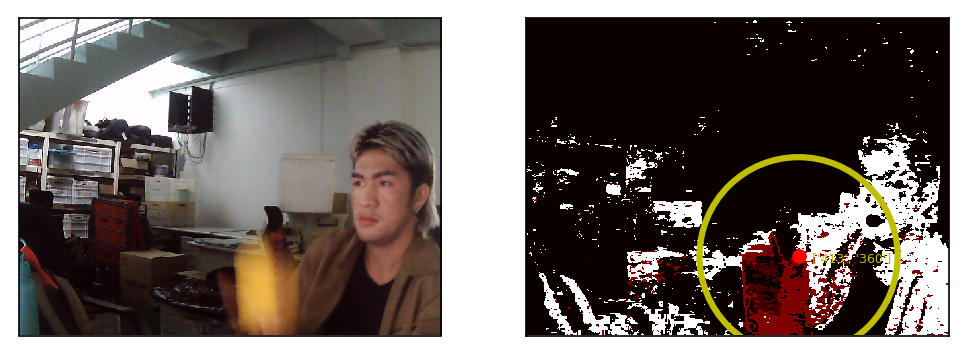

Processing Frame: 39


<Figure size 432x288 with 0 Axes>

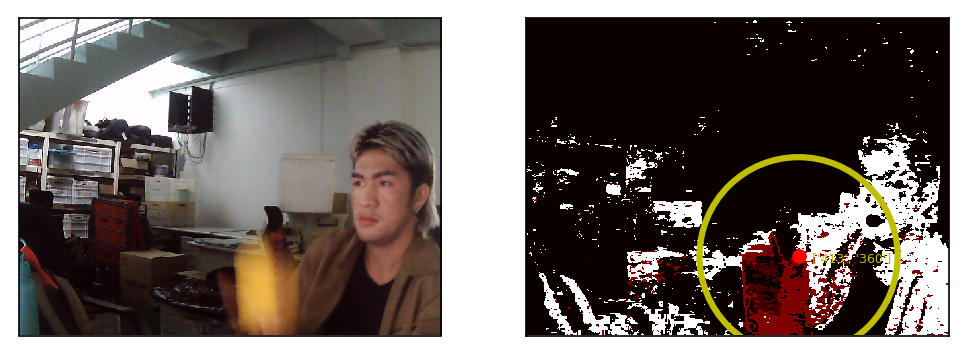

Processing Frame: 40


<Figure size 432x288 with 0 Axes>

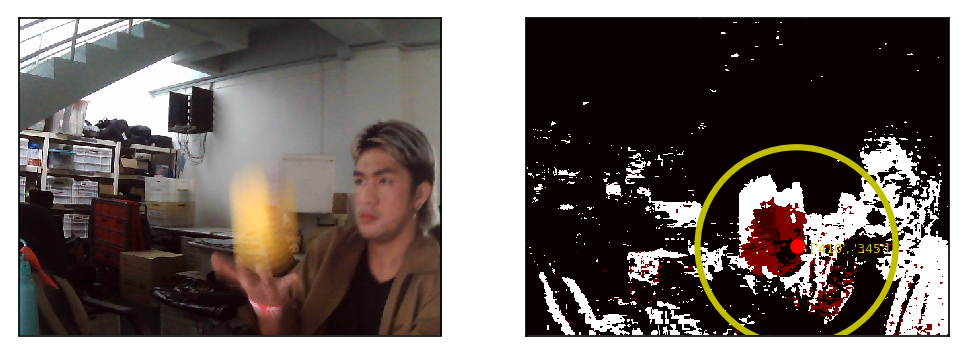

Processing Frame: 41


<Figure size 432x288 with 0 Axes>

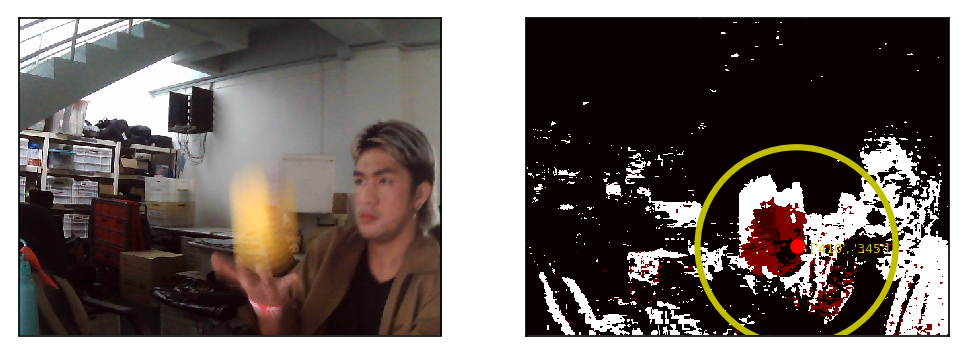

Processing Frame: 42


<Figure size 432x288 with 0 Axes>

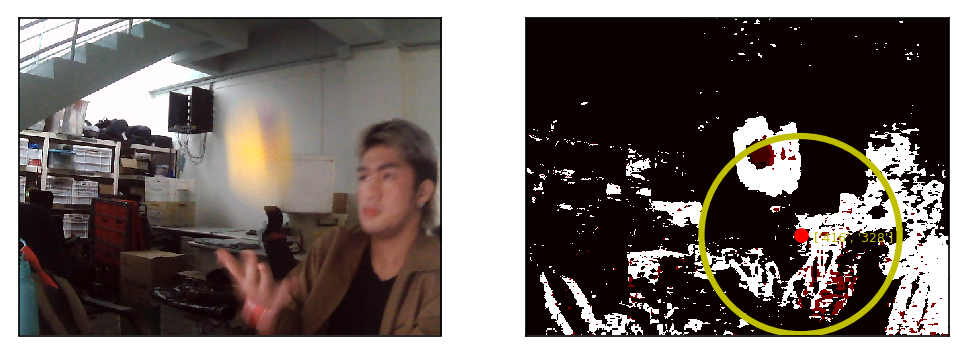

Processing Frame: 43


<Figure size 432x288 with 0 Axes>

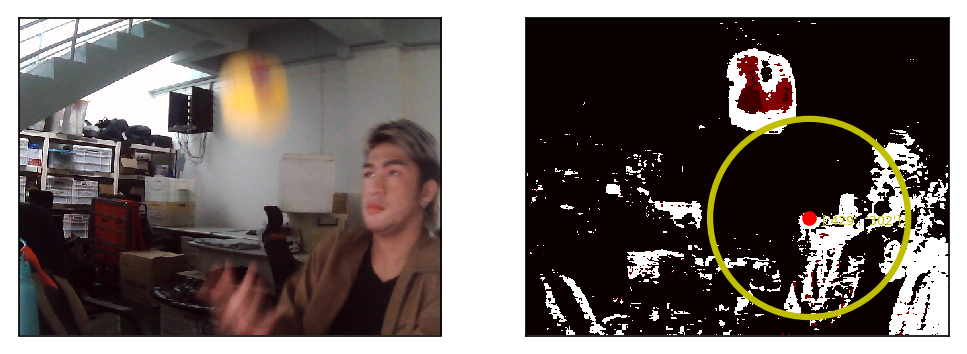

Processing Frame: 44


<Figure size 432x288 with 0 Axes>

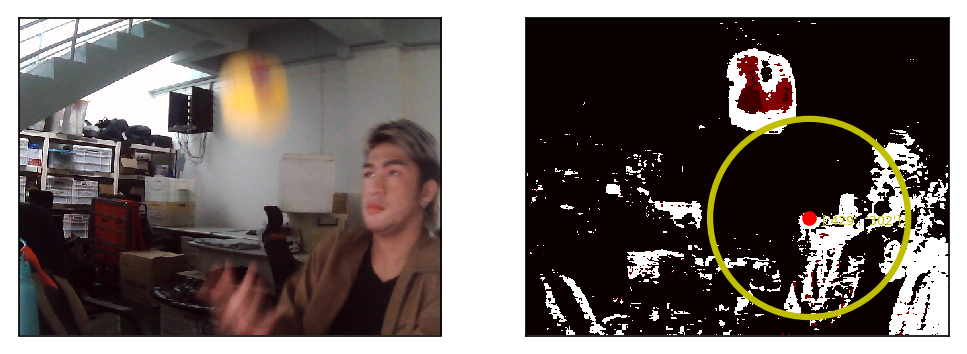

Processing Frame: 45


<Figure size 432x288 with 0 Axes>

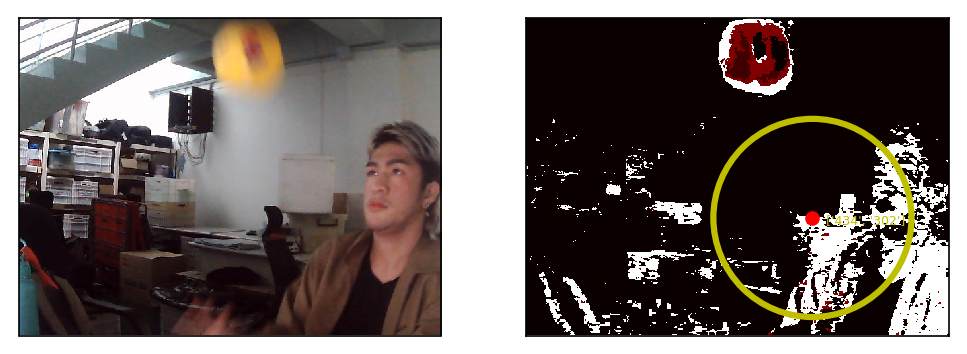

Processing Frame: 46


<Figure size 432x288 with 0 Axes>

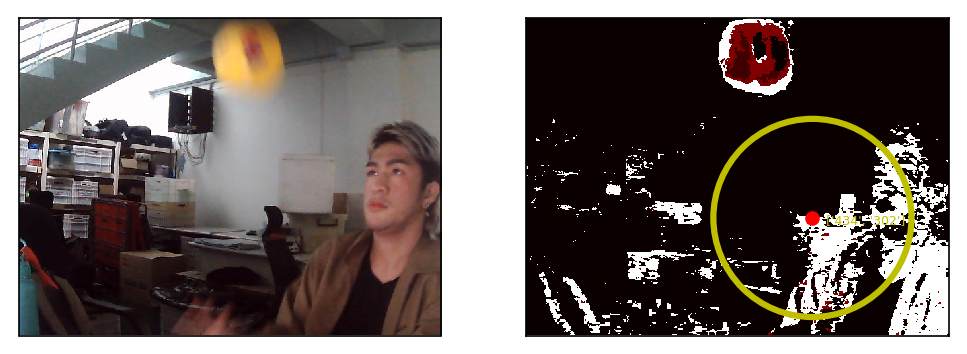

Processing Frame: 47


<Figure size 432x288 with 0 Axes>

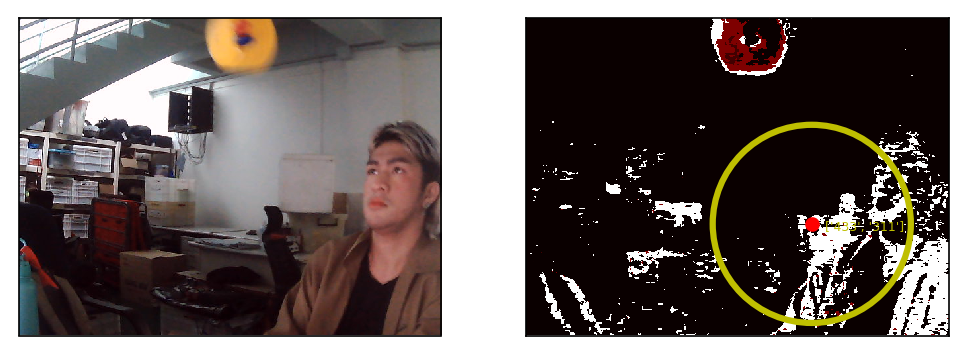

Processing Frame: 48


<Figure size 432x288 with 0 Axes>

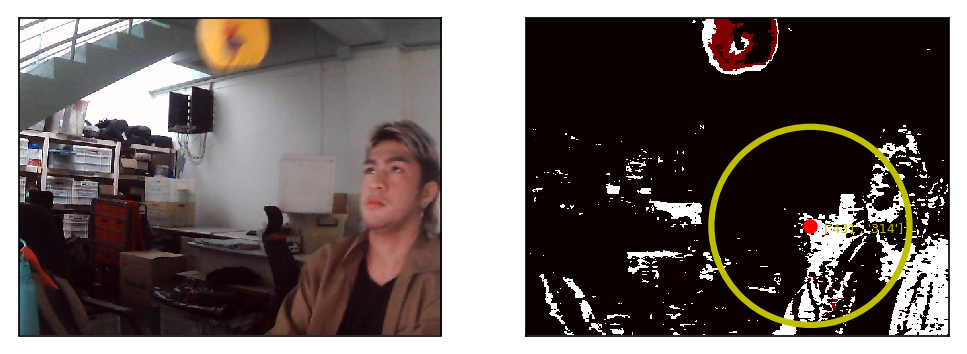

<Figure size 432x288 with 0 Axes>

In [282]:
segmented_ = []

captures = []
tracked = []

CX = []
CY = []

for i in range(len(test_)):
    print("Processing Frame: " + str(i))
    fig, ax = plt.subplots(1,2, figsize = (8,3), dpi = 150)

    ax[0].imshow(cv2.cvtColor(test_[i], cv2.COLOR_BGR2RGB))
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    
    
    segmented = Non_parametric(test_[i], ROI, BINS = 15)
    segmented_.append(segmented)
 
    ret, thresh = cv2.threshold(segmented, 100,255, 0)
    M = cv2.moments(thresh)
    cX = int(M["m10"] / M["m00"])
    cY = int(M["m01"] / M["m00"])
    CX.append(cX)
    CY.append(cY)
    
    ax[1].imshow(segmented_[i], cmap = 'hot')

    circle = plt.Circle((cX, cY), 150, linewidth=3,edgecolor='y',facecolor='none')
    ax[1].add_patch(circle)
    ax[1].plot(cX, cY, 'ro')
    ax[1].text(cX+20,cY+10,[str(int(cX)),str(int(cY))], color = "y", fontsize = 6)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_xlim(0,640)
    ax[1].set_ylim(480,0)
    plt.show()
    plt.tight_layout()

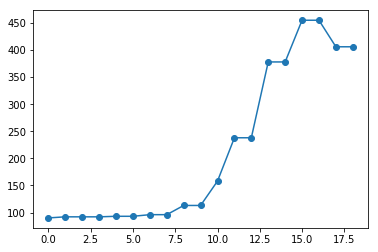

In [266]:
plt.plot(CY, "o-")


(480, 0)

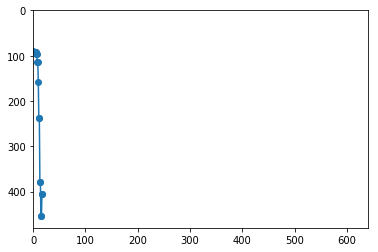

In [264]:
plt.plot(CX, CY, "-", lw = 1)
plt.plot(CY, "o-")

# for i in range(len(CX)):
#     plt.plot(CX[i], CY[i], "o", color = plt.cm.plasma(i/len(CX)))

plt.xlim(0,640)
plt.ylim(480,0)

In [265]:
CY

[90,
 92,
 92,
 92,
 93,
 93,
 96,
 96,
 113,
 113,
 158,
 238,
 238,
 378,
 378,
 455,
 455,
 406,
 406]

In [231]:
from IPython.display import HTML

import matplotlib.animation as animation
ani1 = animation.ArtistAnimation(fig, captures, interval=100, blit=True,
                                repeat_delay=1000)
HTML(ani1.to_jshtml())

In [232]:
ani2 = animation.ArtistAnimation(fig2, tracked, interval=100, blit=True,
                                repeat_delay=1000)
HTML(ani2.to_jshtml())

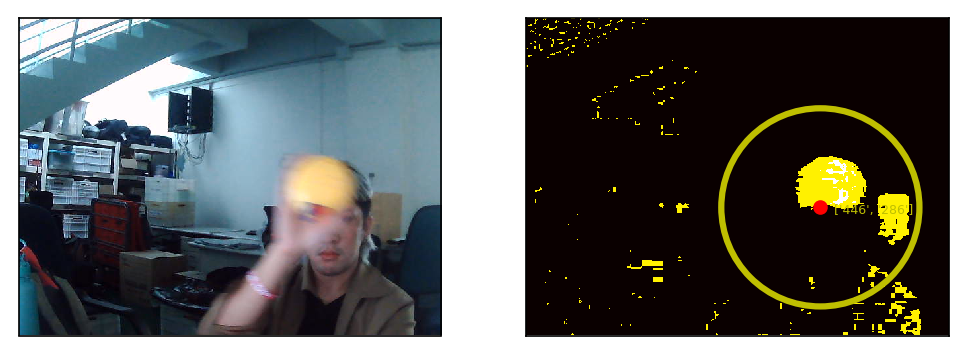

<Figure size 432x288 with 0 Axes>

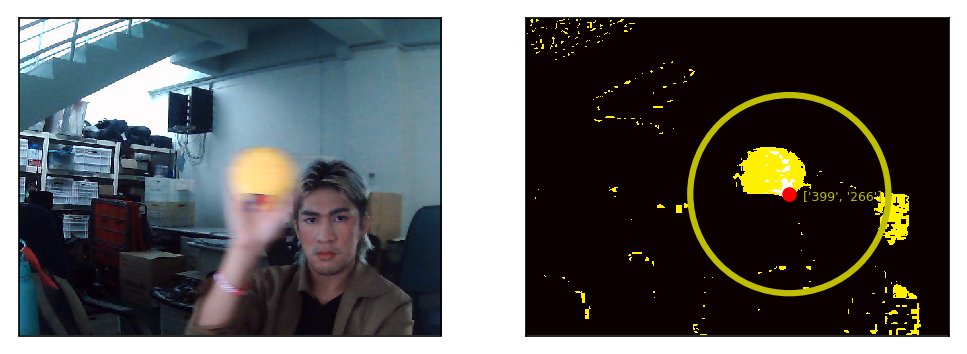

<Figure size 432x288 with 0 Axes>

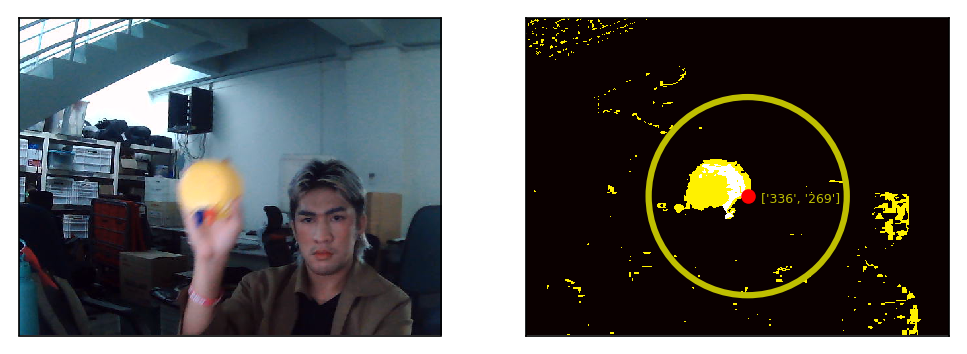

<Figure size 432x288 with 0 Axes>

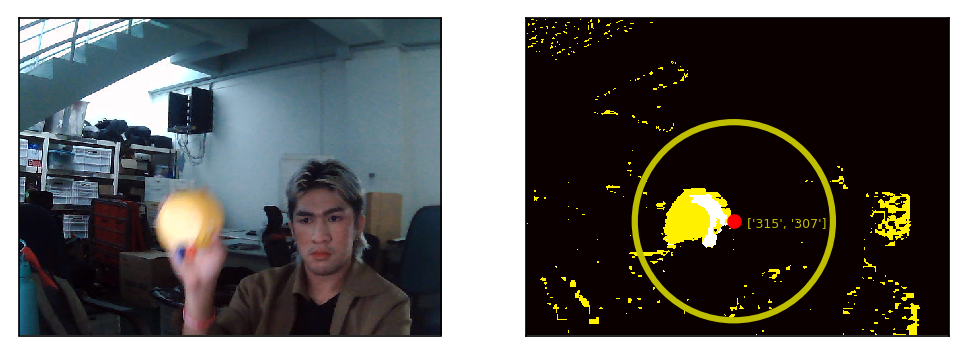

<Figure size 432x288 with 0 Axes>

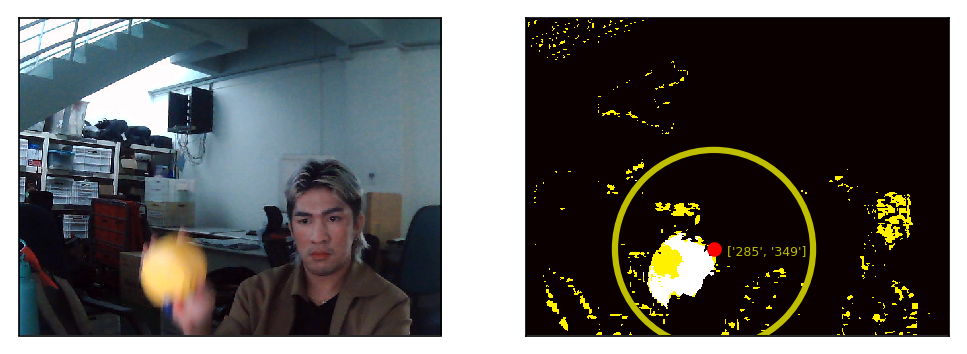

<Figure size 432x288 with 0 Axes>

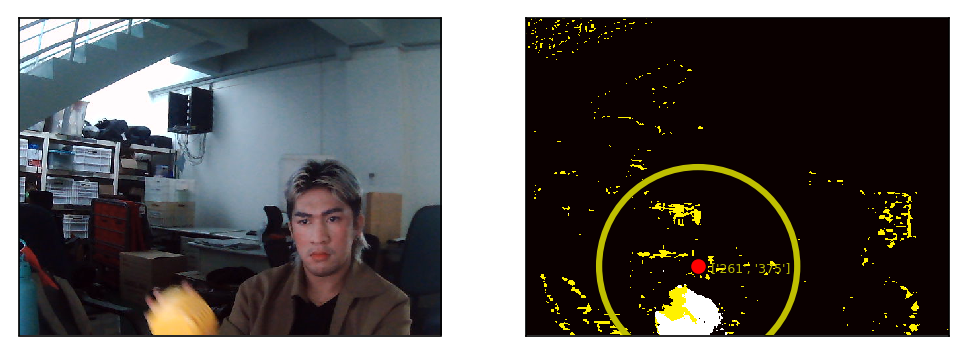

<Figure size 432x288 with 0 Axes>

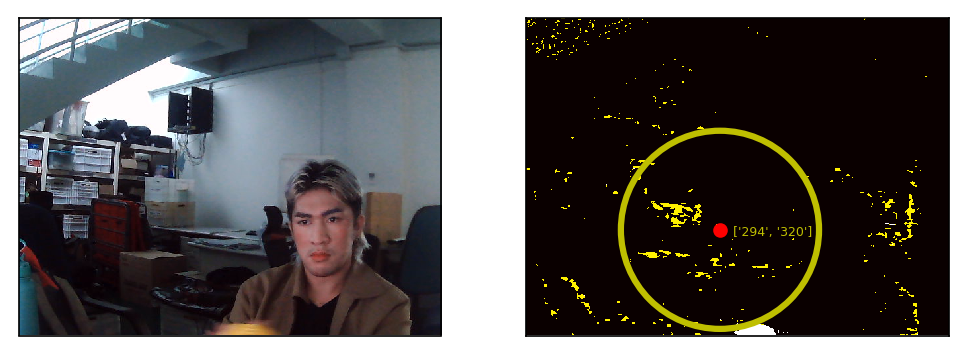

<Figure size 432x288 with 0 Axes>

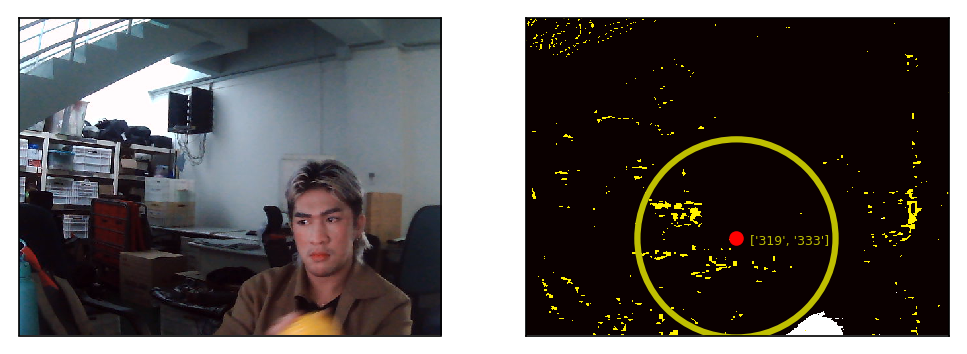

<Figure size 432x288 with 0 Axes>

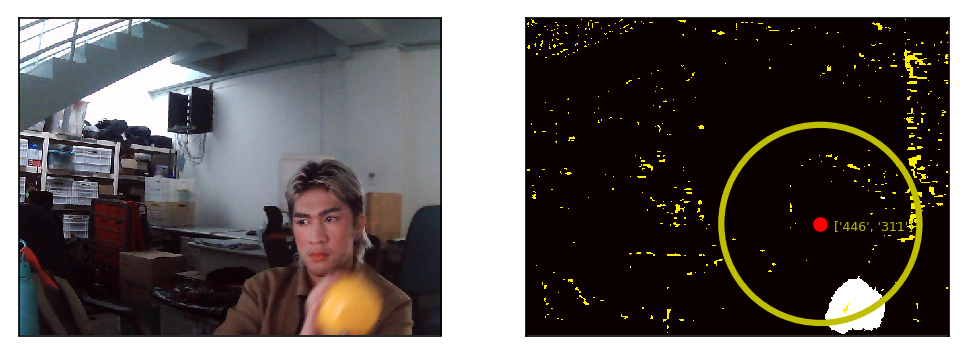

<Figure size 432x288 with 0 Axes>

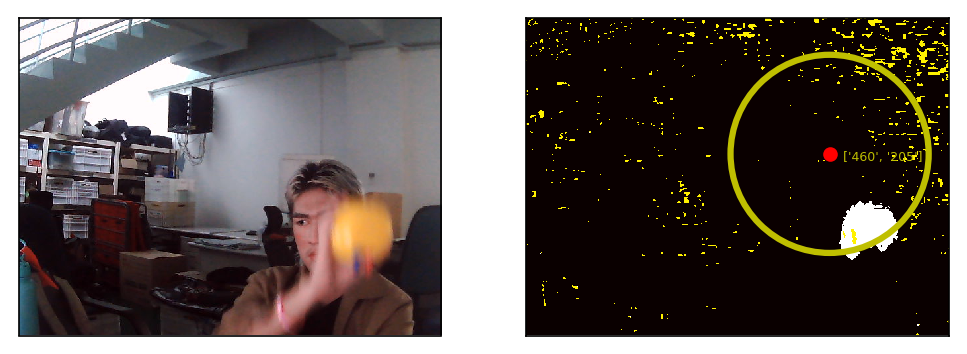

<Figure size 432x288 with 0 Axes>

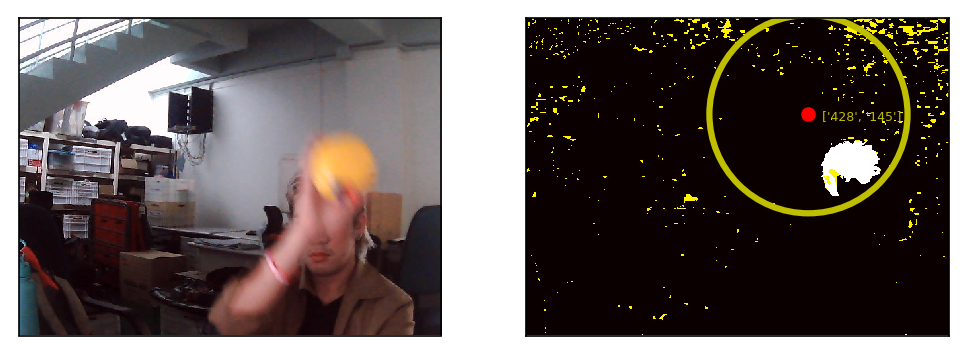

<Figure size 432x288 with 0 Axes>

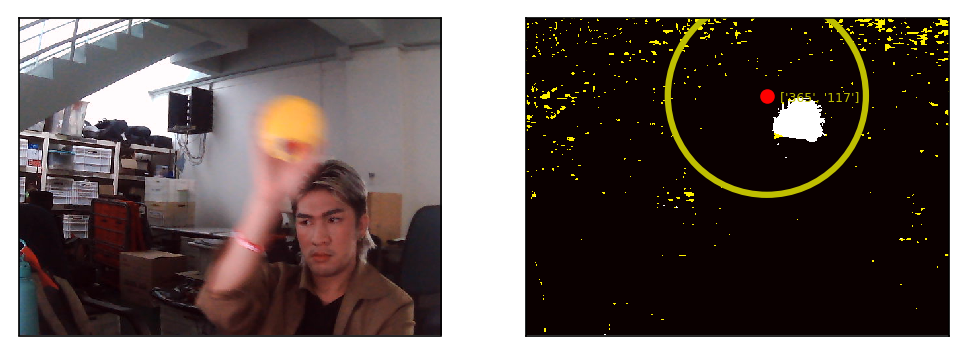

<Figure size 432x288 with 0 Axes>

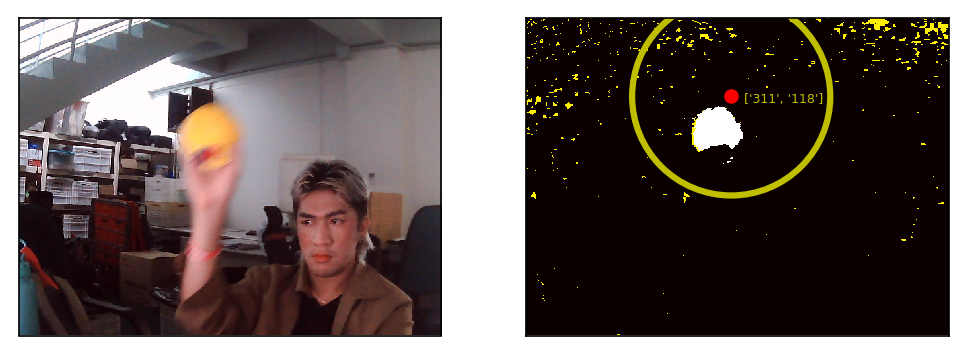

<Figure size 432x288 with 0 Axes>

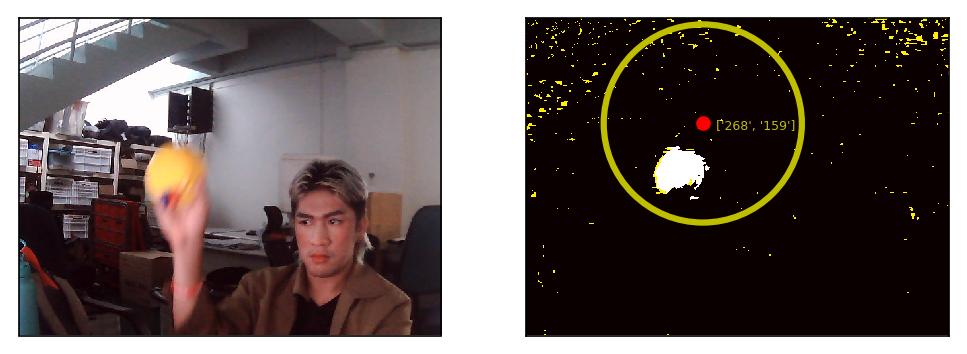

<Figure size 432x288 with 0 Axes>

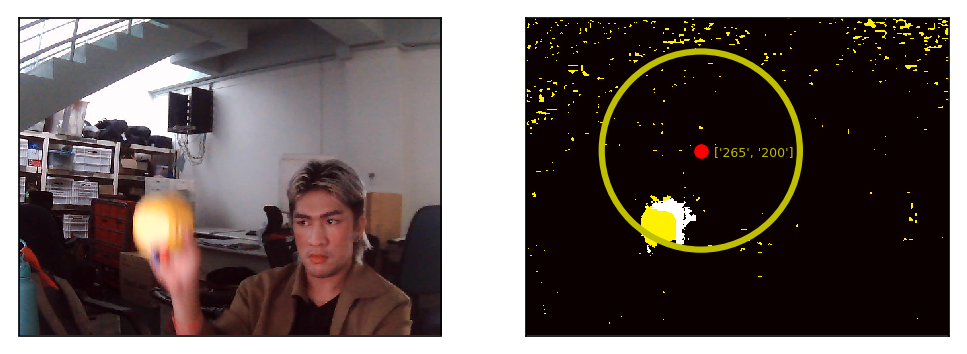

<Figure size 432x288 with 0 Axes>

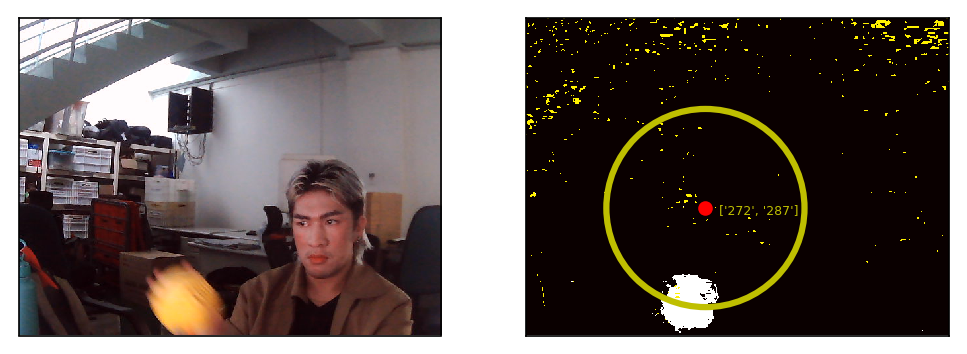

<Figure size 432x288 with 0 Axes>

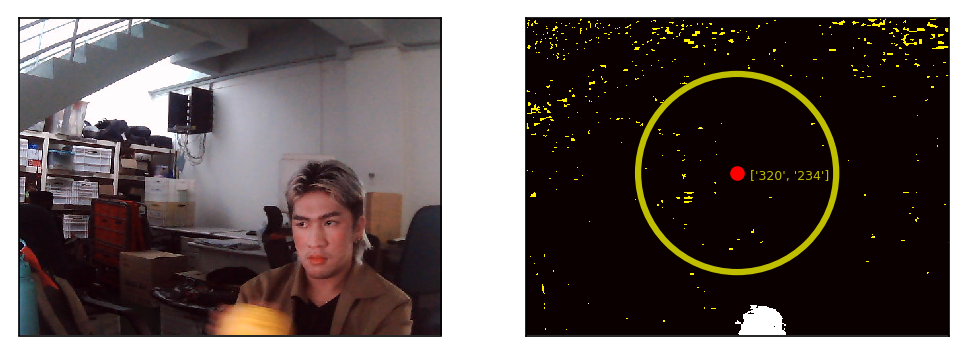

<Figure size 432x288 with 0 Axes>

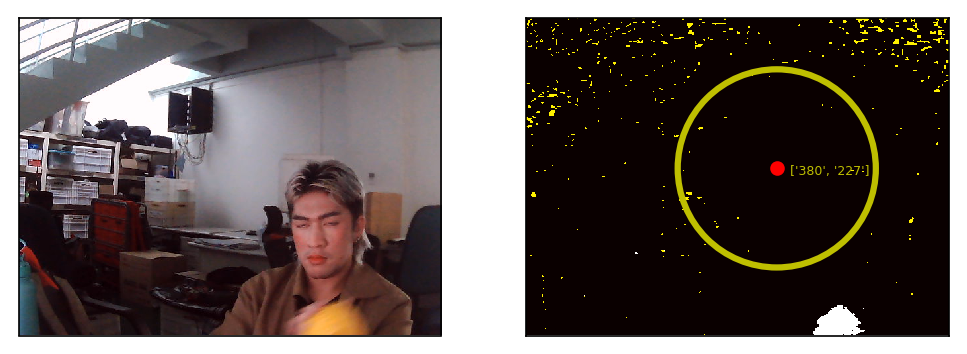

<Figure size 432x288 with 0 Axes>

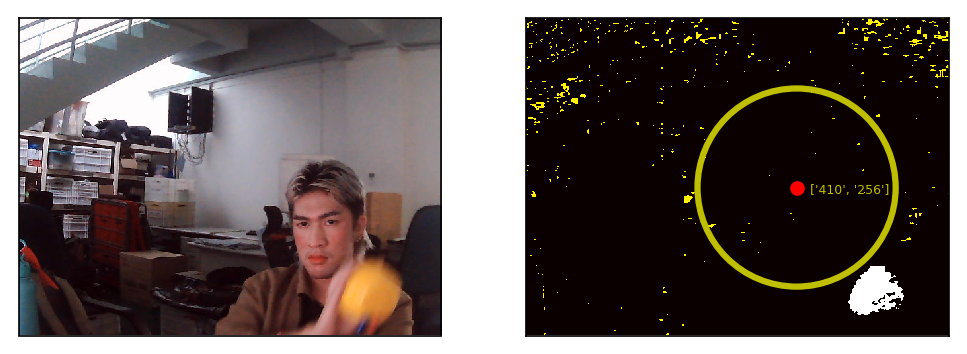

<Figure size 432x288 with 0 Axes>

In [233]:

for i in range(len(CX)):
    fig, ax = plt.subplots(1,2, figsize = (8,3), dpi = 150)

    ax[0].imshow(cv2.cvtColor(test_[i], cv2.COLOR_BGR2RGB))
    ax[0].set_xticks([])
    ax[0].set_yticks([])

    ax[1].imshow(segmented_[i], cmap = 'hot')

    circle = plt.Circle((CX[i], CY[i]), 150, linewidth=3,edgecolor='y',facecolor='none')
    ax[1].add_patch(circle)
    ax[1].plot(CX[i], CY[i], 'ro')
    ax[1].text(CX[i]+20,CY[i]+10,[str(int(CX[i])),str(int(CY[i]))], color = "y", fontsize = 6)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_xlim(0,640)
    ax[1].set_ylim(480,0)
    plt.show()
    plt.tight_layout()

(480, 0)

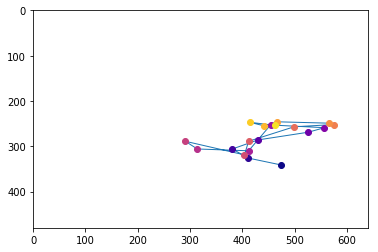

In [213]:
plt.plot(CX, CY, "-", lw = 1)

for i in range(len(CX)):
    plt.plot(CX[i], CY[i], "o", color = plt.cm.plasma(i/len(CX)))

plt.xlim(0,640)
plt.ylim(480,0)

In [104]:
M = cv2.moments(thresh)
cX = int(M["m10"] / M["m00"])
cY = int(M["m01"] / M["m00"])


In [51]:
plt.Circle((cX, cY), 2)
plt.show()

In [23]:
A = measure.label(segmented, connectivity=2)

AREA = []

In [25]:
for region in measure.regionprops(A):
    if 10 > region.area > 50000:
        y, x = region.centroid
        CX.append(x)
        CY.append(y)
        AREA.append(region.area)

In [31]:
region = measure.regionprops(A)

In [13]:
params = cv2.SimpleBlobDetector_Params()

params.filterByArea = True
params.minArea = 100

detector = cv2.SimpleBlobDetector_create(params)
keypoints = detector.detect(segmented/segmented.max())

# blank = np.zeros((1, 1))
# blobs = cv2.drawKeypoints(test, keypoints, blank, (0, 0, 255),cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)


error: OpenCV(4.5.3) C:\Users\runneradmin\AppData\Local\Temp\pip-req-build-czu11tvl\opencv\modules\features2d\src\blobdetector.cpp:317: error: (-210:Unsupported format or combination of formats) Blob detector only supports 8-bit images! in function 'cv::SimpleBlobDetectorImpl::detect'


In [12]:
segmented.max()

1591.0

In [ ]:
cv2.imshow("Blobs Using Area", blobs)
cv2.waitKey(0)
cv2.destroyAllWindows()

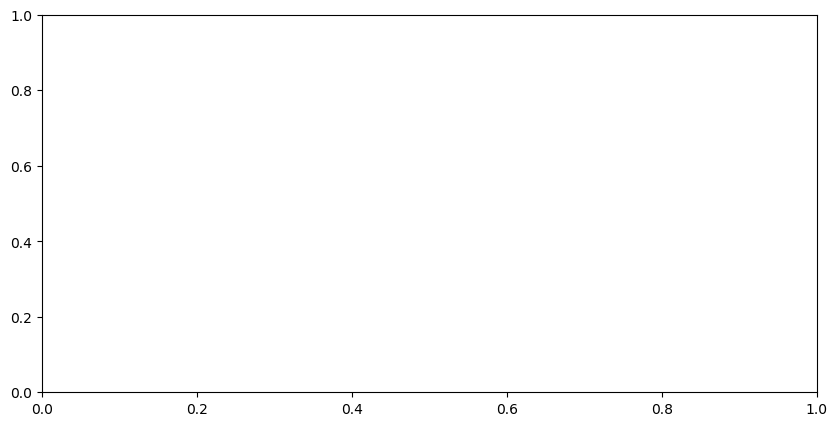

In [205]:
fig = plt.figure(figsize = [10,5], dpi = 100)
ax1 = fig.add_subplot(111)

A = measure.label(segmented, connectivity=2)

CX = []
CY = []
AREA = []

for region in measure.regionprops(A):
    if 10 > region.area > 50000:
        y, x = region.centroid
        CX.append(x)
        CY.append(y)
        
        AREA.append(region.area)
#         ax1.imshow(segmented, cmap = 'gray')
#         ax1.plot(x,y, 'ro')  
#         major, minor = region.major_axis_length, region.minor_axis_length
       
#         th = np.degrees(region.orientation)
#         ellipse = patch.Ellipse((x, y), major, minor, th,
#                              fill=False, ec='y', lw=5)
#         ax1.add_patch(ellipse)
#         ax1.text(x+15,y+10,[str(int(x)),str(int(y))], color = "b")

In [206]:
CX

[]

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:24: RuntimeWarning: invalid value encountered in true_divide
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: RuntimeWarning: invalid value encountered in true_divide


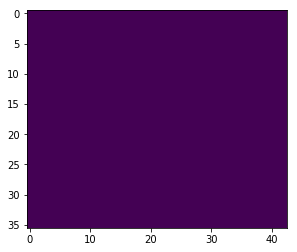

In [6]:
path = ".\\capture\\"

In [7]:
import cv2

camera = cv2.VideoCapture(0)
i = 0
while i < 5:
    input('Press Enter to capture')
    return_value, image = camera.read()
    cv2.imwrite(path + str(i)+ '.png', image)
    i += 1
del(camera)

Press Enter to capture


error: OpenCV(4.5.3) C:\Users\runneradmin\AppData\Local\Temp\pip-req-build-czu11tvl\opencv\modules\imgcodecs\src\loadsave.cpp:803: error: (-215:Assertion failed) !_img.empty() in function 'cv::imwrite'


In [14]:
img = cv2.imread(path + '0.png')
r = cv2.selectROI(img)
ROI = img[int(r[1]):int(r[1]+r[3]), int(r[0]):int(r[0]+r[2])]

In [12]:
cv2.imshow("image", img)

In [2]:
ball = cv2.imread("ball.jpg")

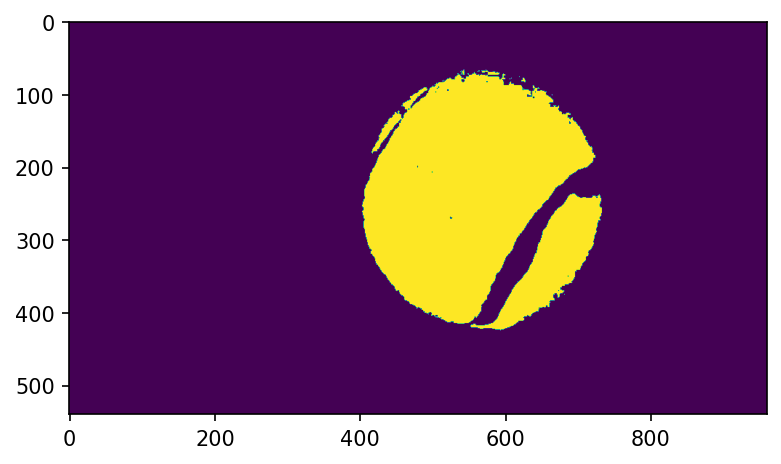

In [6]:
Segmented = Non_Parametric_Segmentation(ball,15,BINS=15)
plt.figure(dpi = 150)
plt.imshow(Segmented)

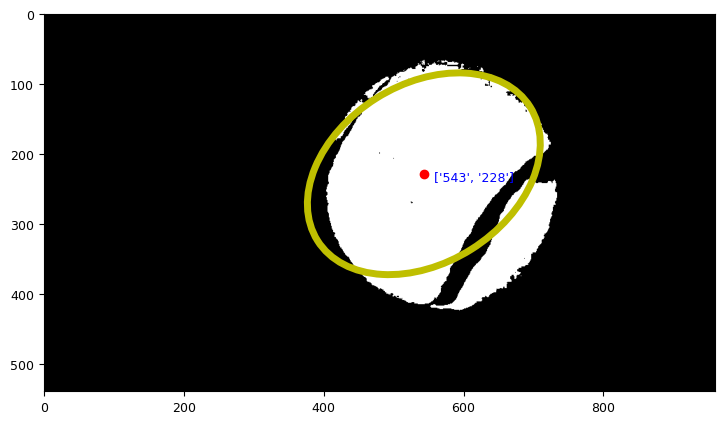

In [7]:
fig = plt.figure(figsize = [10,5], dpi = 100, facecolor = 'w')
plt.rcParams.update({'font.size' : 9})
plt.rcParams['axes.titlesize'] = 15
ax1 = fig.add_subplot(111)

A = measure.label(Segmented, connectivity=2)

CX = []
CY = []
AREA = []

for region in measure.regionprops(A):
    if 100000 > region.area > 50000:
        y, x = region.centroid
        CX.append(x)
        CY.append(y)
        
        AREA.append(region.area)
        ax1.imshow(Segmented, cmap = 'gray')
        ax1.plot(x,y, 'ro')  
        major, minor = region.major_axis_length, region.minor_axis_length
       
        th = np.degrees(region.orientation)
        ellipse = patch.Ellipse((x, y), major, minor, th,
                             fill=False, ec='y', lw=5)
        ax1.add_patch(ellipse)
        ax1.text(x+15,y+10,[str(int(x)),str(int(y))], color = "b")


In [6]:
# import cv2
# vidcap = cv2.VideoCapture('ball_drop.mp4')
# success,image = vidcap.read()
# count = 0
# success = True
# while success:
#     success,image = vidcap.read()
#     cv2.imwrite("frames/frame%d.jpg" % count, image)     # save frame as JPEG file
#     if cv2.waitKey(10) == 27:                     # exit if Escape is hit
#         break
#     count += 1

In [ ]:
i = 200
img = cv2.imread("frames/frame"+str(i)+".jpg")
r = cv2.selectROI(img)
ROI = img[int(r[1]):int(r[1]+r[3]), int(r[0]):int(r[0]+r[2])]

Segmented = Non_Parametric_Segmentation(img, ROI,25)
Segmented = Segmented/Segmented.max()
plt.figure(dpi = 150)
plt.imshow(Segmented)

In [ ]:
plt.figure(dpi = 150)
Segmented[Segmented>0.3] = 1
plt.imshow(Segmented)
plt.colorbar()

C:\Users\renep\AppData\Local\Temp/ipykernel_8036/2227228861.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize = [10,8], dpi = 100, facecolor = 'w')


TypeError: unsupported operand type(s) for /: 'NoneType' and 'int'

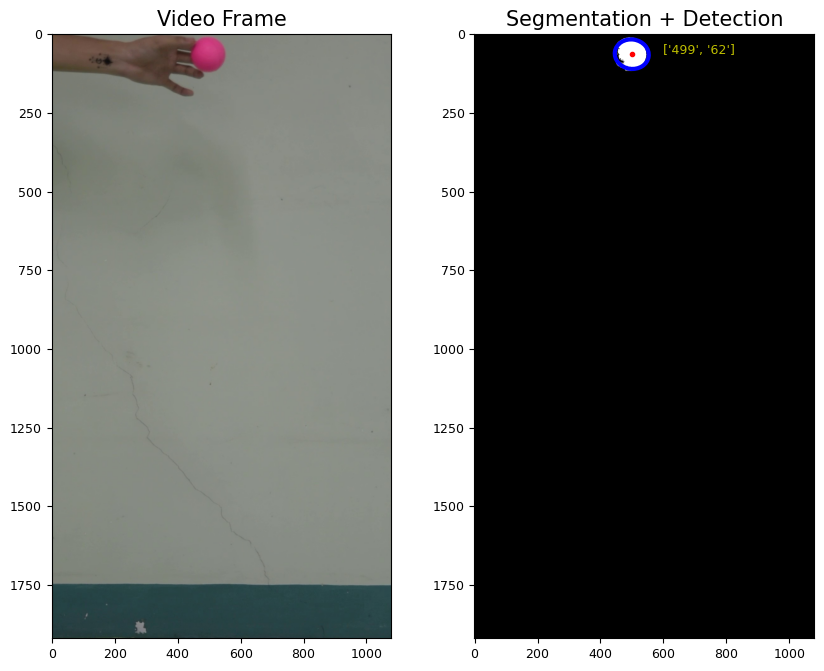

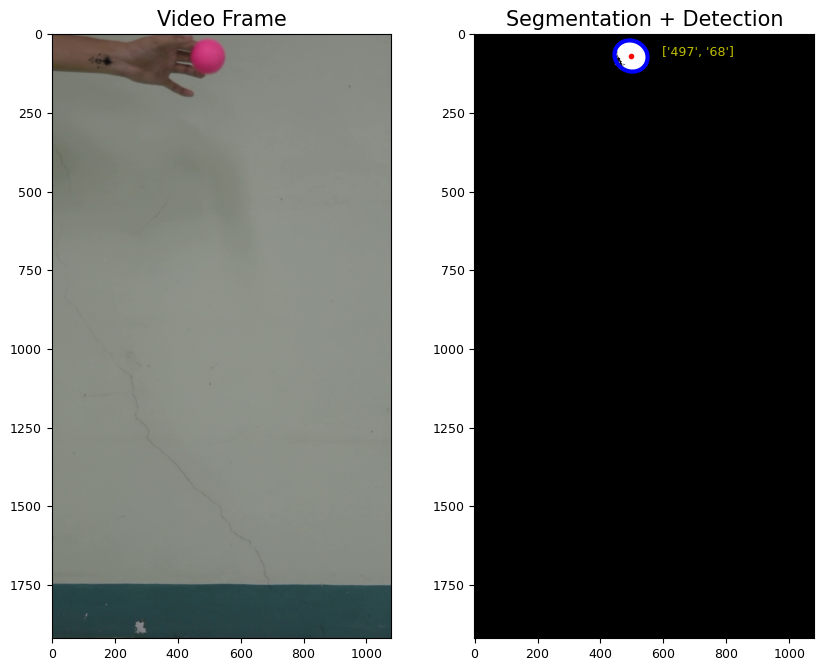

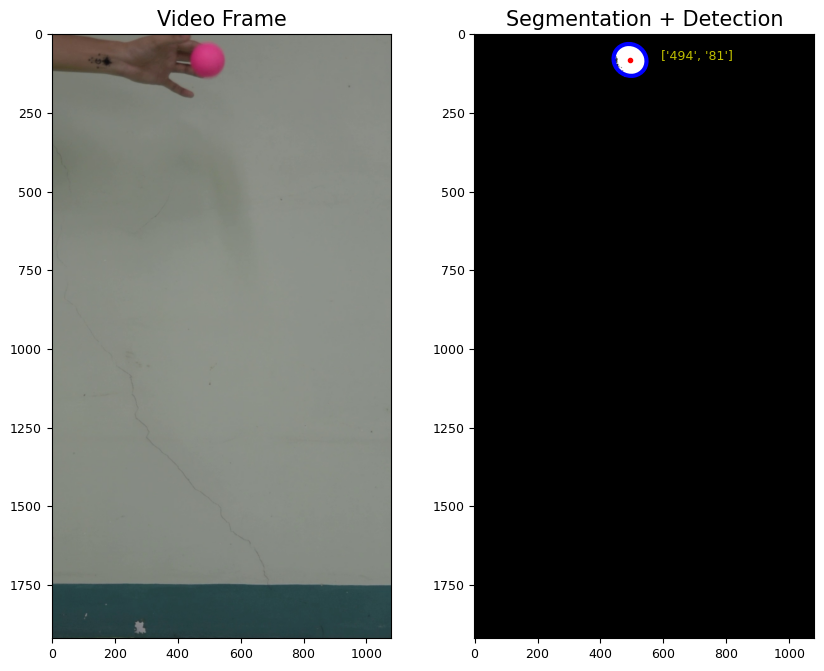

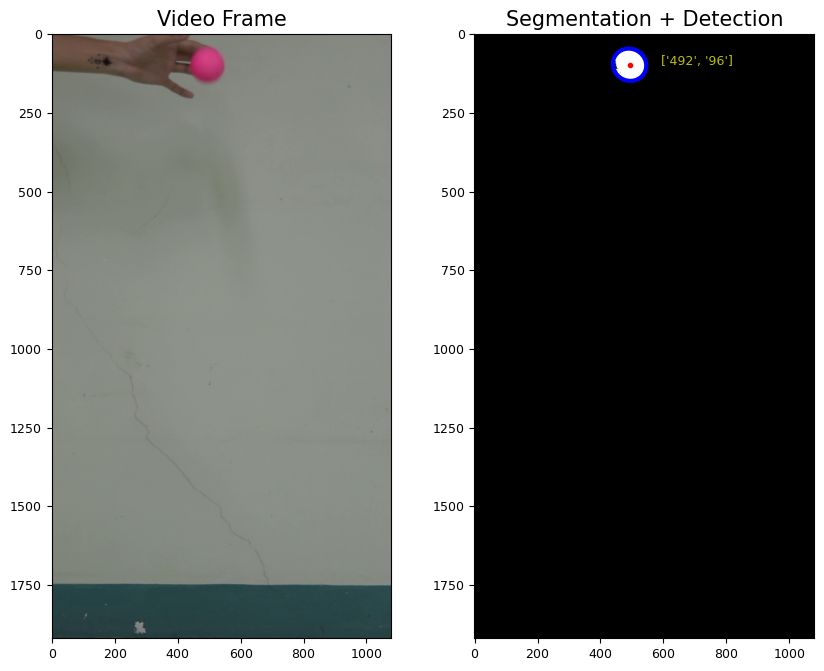

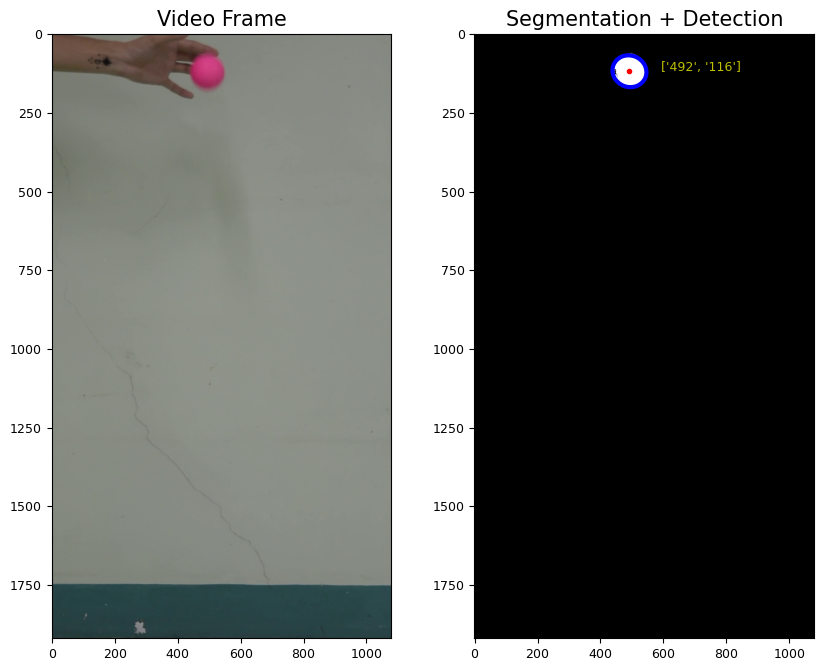

...

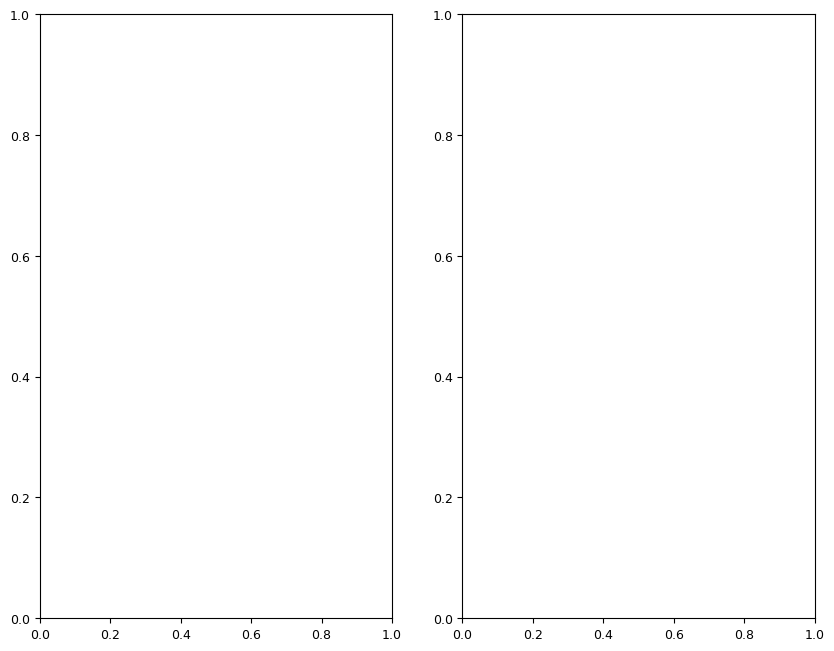

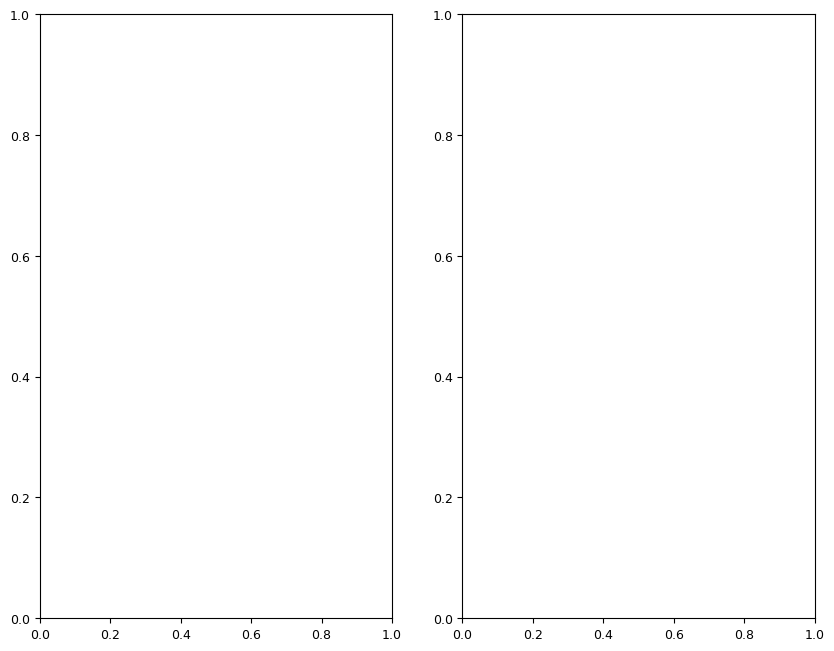

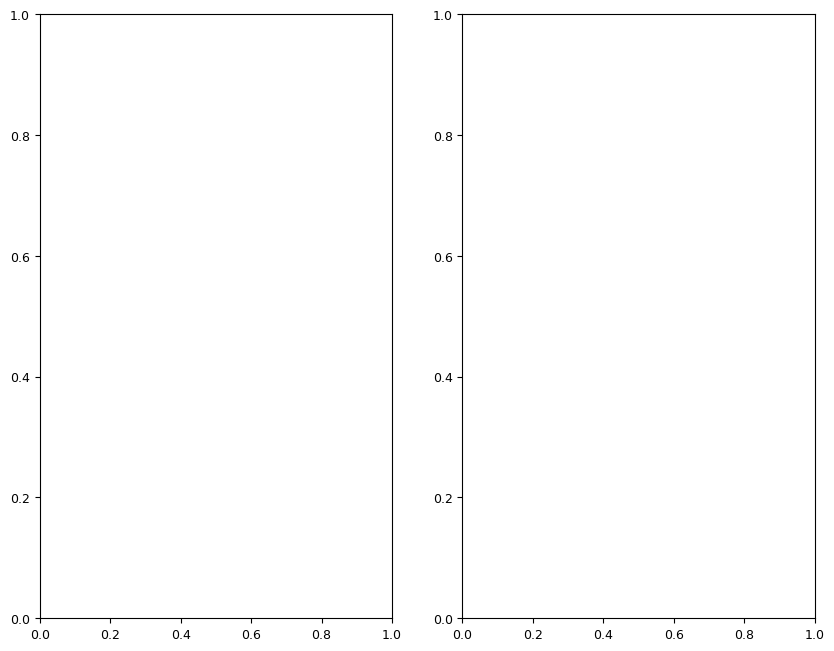

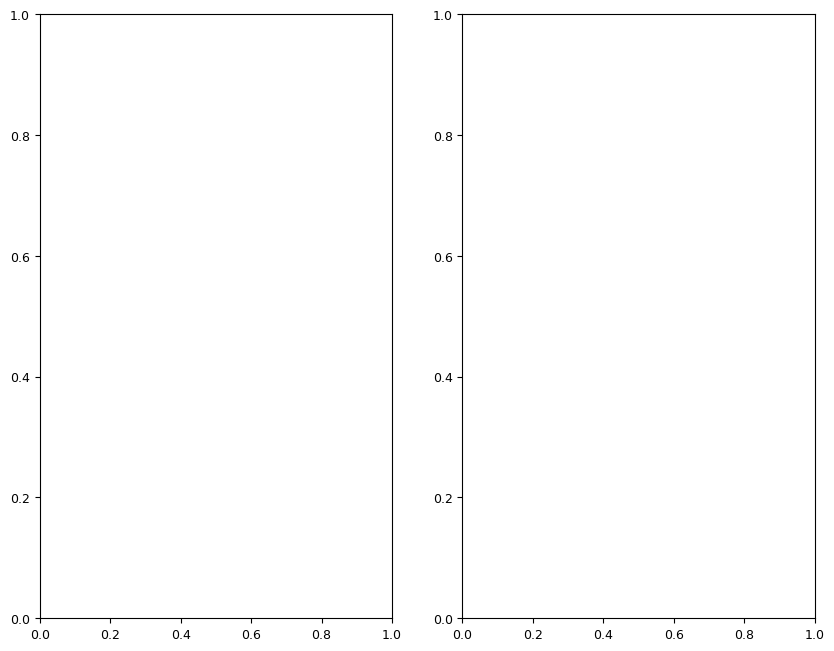

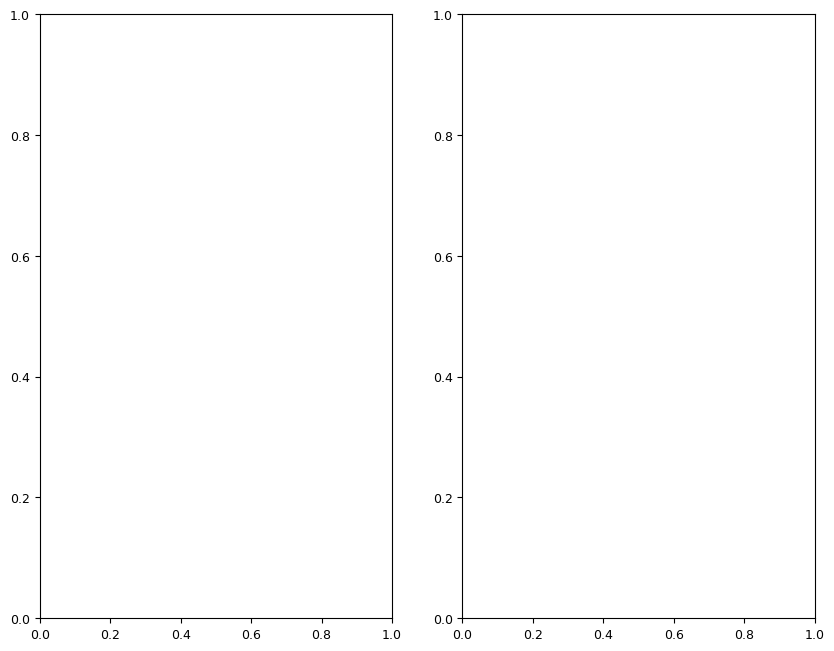

In [12]:
CX = []
CY = []
MAJOR = []
MINOR = []
counts = 119

for i in range(counts):
    fig = plt.figure(figsize = [10,8], dpi = 100, facecolor = 'w')
    plt.rcParams.update({'font.size' : 9})
    plt.rcParams['axes.titlesize'] = 15
    ax1 = fig.add_subplot(121)
    ax2 = fig.add_subplot(122)

    img = cv2.imread("frames/frame"+str(i)+".jpg")
    Segmented = Non_Parametric_Segmentation(img, ROI,25)
    Segmented = Segmented/Segmented.max()
    Segmented[Segmented>0.3] = 1
    A = measure.label(Segmented, connectivity=2)
    
    for region in measure.regionprops(A):
        if region.area > 500:
            y, x = region.centroid
            CX.append(x)
            CY.append(y)
            ax1.set_title("Video Frame")
            ax1.imshow(img[:,:,::-1])
            ax2.set_title("Segmentation + Detection")
            ax2.imshow(Segmented, cmap = 'gray')
            ax2.plot(x,y, 'r.')  
            major, minor = region.major_axis_length, region.minor_axis_length
            MAJOR.append(major)
            MINOR.append(minor)
            th = np.degrees(region.orientation)
            ellipse = patch.Ellipse((x, y), major, minor, th,
                                 fill=False, ec='b', lw=3)
            ax2.add_patch(ellipse)
            ax2.text(x+100,y+0,[str(int(x)),str(int(y))], color = "y")
            a
            plt.savefig("segmented/frame" + str(i) +".jpg")
    

Text(0.5, 0, 'time, s')

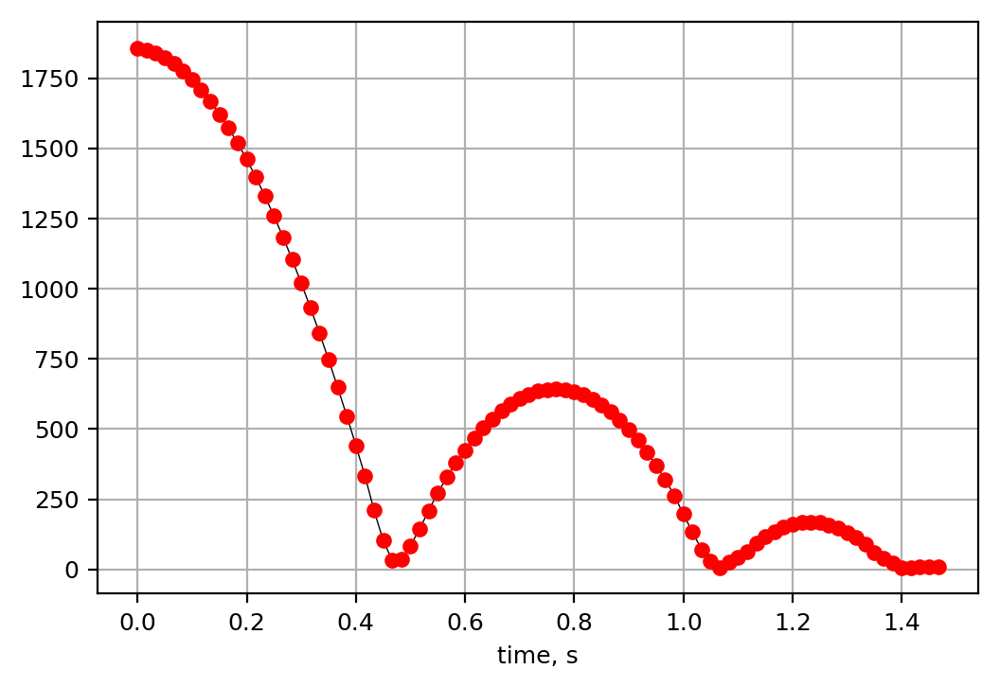

In [121]:
plt.figure(dpi = 200, facecolor = 'w')
fps = 60
duration = len(CY)/fps
t = np.arange(0, duration-1/fps, 1/fps)
plt.plot(t, -np.array(CY[:-1])+ 1920, 'k-', lw = 0.5)
plt.plot(t, -np.array(CY[:-1])+ 1920, 'ro', ms = 5)
plt.grid()
plt.xlabel("time, s")

In [126]:
np.mean(MAJOR[:25])


104.65549301533405

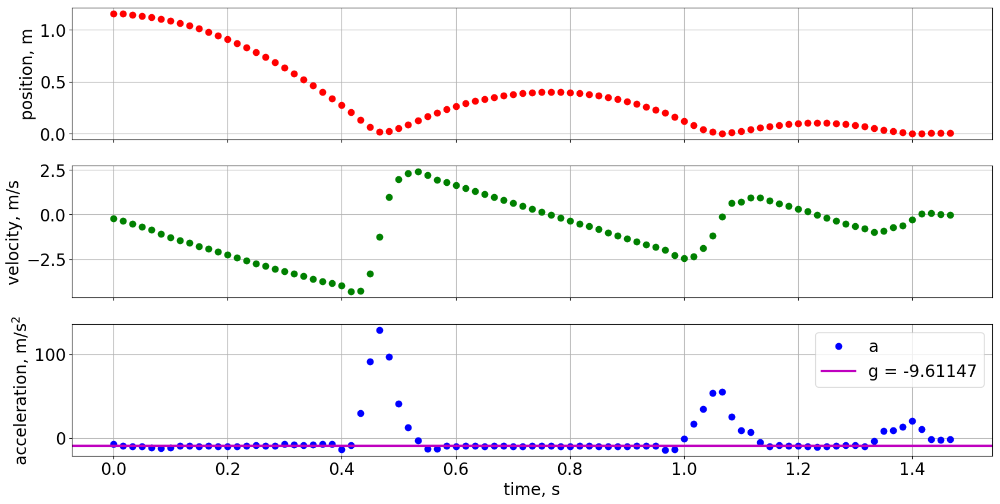

In [144]:
plt.figure(figsize=[20,10], dpi = 100, facecolor = 'w')
plt.rcParams.update({'font.size' : 20})
plt.rcParams['axes.titlesize'] = 15
fps = 60
duration = len(CY)/fps
t = np.arange(0, duration-1/fps, 1/fps)
y = (-np.array(CY[:-1])+ 1920)*0.065/104.65

dt = t[1]-t[0]
dtdy = np.gradient(y, dt)

dt2d2y = np.gradient(dtdy, dt)


ax1 = plt.subplot(3,1,1)
plt.plot(t, y, 'r.', ms = 15)
plt.grid()
plt.ylabel("position, m")
plt.setp(ax1.get_xticklabels(), visible=False)


ax2 = plt.subplot(3,1,2)
plt.plot(t, dtdy, 'g.', ms = 15)
plt.grid()
plt.ylabel("velocity, m/s")
plt.setp(ax2.get_xticklabels(), visible=False)


ax3 = plt.subplot(3,1,3)

g = np.mean(dt2d2y[:25])
plt.plot(t, dt2d2y, 'b.', ms = 15)
plt.grid()
plt.ylabel("acceleration, m/s$^2$")
plt.xlabel("time, s")
plt.axhline(g, color = 'm', lw = 3)
plt.legend(["a", "g = " + str(np.round(g,5))])
plt.show()

In [84]:
dt = t[1]-t[0]

550 pixels = 0.065 m

In [86]:
dtdx = np.gradient(y, dt)

In [132]:
np.mean(dt2d2y[:25])

-9.611474609871678

In [128]:
0.065/104.65

0.0006211180124223603

In [113]:
Segmented.shape

(1920, 1080)